# импорт пакетов

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.collections import LineCollection

from sklearn import preprocessing
from sklearn import metrics
from sklearn.impute import SimpleImputer
from sklearn.impute import KNNImputer
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
import sklearn.metrics as mtrcs
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import GridSearchCV


import seaborn as sns
from IPython.display import display
sns.set()
sns.set_context("talk")

%matplotlib inline

# пишем функции для массовой обработки

In [ ]:
def drawColumnAsTimeSeries(data, name, trueName=None, drawSeqLine=True):

    # значения заполненных данных
    y1=data[name][data[name].notna()].values
    # индексы заполненных данных (от 1 до ...) для графиков
    x1=data[name][data[name].notna()].index+1
    # индексы пропущенных данных (от 1 до ...) для графиков
    x2=data[name][data[name].isnull()].index+1
    # массив для значений интерполированных данных
    y2=np.zeros(len(x2))

    fig, ax = plt.subplots(figsize=(25,5))
    ax.scatter(x1,y1, color='green', marker='d', label='данные')
    if drawSeqLine:
        a=x1[0]
        xx1=[]
        xx1.append(x1[0])
        yy1=[]
        yy1.append(y1[0])
        collect=[]
        for i in range(len(x1)-1):
            if (x1[i+1]-a)==1:
                xx1.append(x1[i+1])
                yy1.append(y1[i+1])
                a=x1[i+1]
            else:
                if len(xx1)>1:
                    ax.plot(xx1,yy1, color='blue')
                a=x1[i+1]
                xx1=[]
                xx1.append(x1[i+1])
                yy1=[]
                yy1.append(y1[i+1])        

    ax.scatter(x2,y2, color='orange', marker='.', label='пропущенные значения (0)')
    ax.hlines(np.mean(y1),1,len(data.index), color='red', label='среднее')
    ax.set_xlim(1,365)
    ax.legend(fontsize=14)
    if trueName==None:
        ax.set_title(name, fontsize=16)
    else:
        ax.set_title(trueName, fontsize=16)
    # plt.savefig('report_v2/missingValuesRaw_AE1.png', dpi=300, bbox_inches='tight')
    plt.show()


In [ ]:
def drawFillNan(data, name, trueName):
    y1=data[name][data[name].notna()].values
    x1=data[name][data[name].notna()].index+1

    xEmpty=data[name][data[name].isnull()].index+1
    yMean=np.array(len(xEmpty)*[np.mean(y1)])
    yMedian=np.array(len(xEmpty)*[np.median(y1)])

    xWhole=np.concatenate((x1,xEmpty), axis=None)
    yWholeMean=np.concatenate((y1,yMean), axis=None)[xWhole.argsort()]
    yWholeMedian=np.concatenate((y1,yMedian), axis=None)[xWhole.argsort()]
    xWhole=xWhole[xWhole.argsort()]

    dataAE1=data[name].copy()
    yPad=dataAE1.fillna(method='pad').copy()
    yIntLin=dataAE1.interpolate(method='linear').copy()
    yIntCubic=dataAE1.interpolate(method='cubic').copy()
    yIntQuadr=dataAE1.interpolate(method='quadratic').copy()
    yIntSpline=dataAE1.interpolate(method='spline', order=2).copy() 

    fig, ax = plt.subplots(figsize=(25,5))

    ax.scatter(x1,y1, color='green', marker='d', label='данные')

    ax.plot(xWhole,yWholeMean, color='orange', marker='.', label='Mean')
    #ax.plot(xWhole,yWholeMedian, color='orange', marker='.', label='Median')
    ax.plot(xWhole,yPad.values, color='red', marker='.', label='pad')
    ax.plot(xWhole,yIntLin.values, color='blue', marker='.', label='Interpolation Linear')
    ax.plot(xWhole,yIntCubic.values, color='black', marker='.', label='Interpolation Cubic')
    ax.plot(xWhole,yIntCubic.values, color='green', marker='.', label='Interpolation Quadratic')
    ax.plot(xWhole,yIntCubic.values, color='purple', marker='.', label='Interpolation Spline(2)')
    ax.set_xlim(1,len(data.index))
    #ax.set_xlim(100,130)
    ax.legend(fontsize=14)
    ax.set_title(trueName, fontsize=16)
    #plt.savefig('report_v2/missingValuesInterpollated_AE1.png', dpi=300, bbox_inches='tight')
    plt.show()   


In [ ]:
def drawHistograms(data, name, trueName=None):
    plt.figure(figsize=(12, 8))
    if trueName==None:
        label=name
    else:
        label=trueName
    sns.distplot( data[name], color='g', bins=50, 
            hist_kws={'alpha': 0.5}, axlabel=label )
    plt.show()


In [ ]:
def analyzeMissingValues(data):
    print('=======================================================')
    print('Пропущенные данные (из', len(data.index),'записей):')
    print(data.isnull().sum())
    print('=======================================================')
    print('Пропущенные данные, % (из', len(data.index),'записей):')
    print(data.isnull().sum()/len(data.index)*100)
    print('=======================================================')


In [ ]:
def drawCorrMatrix(data, colomunsToRemove=None, size=None):
    if colomunsToRemove==None:
        corr = data.corr()
    else:
        corr = data.drop(colomunsToRemove, axis=1).corr()
    if size==None:
        plt.figure(figsize=(12, 10))
    else:
        plt.figure(figsize=size)
    ax = sns.heatmap(corr, annot=True, vmax=1, vmin=-1, cmap='RdYlGn')
    ax.set_title('Корреляции независимых переменных', fontsize=20)
    plt.tight_layout(pad=0.4)
    plt.show()


In [ ]:
def analyzeCorrWithTargets(data, targets, threshold=0.3):
    
    print('#################################################')
    print('###### Корреляция с целевыми переменными   ######')
    print('#################################################')
    
    for name in targets:
        print('')
        print('Корреляция с переменной \'',name,'\':')
        display(data.corr()[name].drop(targets).sort_values(ascending=False))
        print('-------------------------------------------------')
            
        if len(data.corr()[name].drop(targets)[abs(data.corr()[name].drop(targets))>threshold].sort_values(ascending=False).values)==0:
            print('Нет корреляций больше заданного порога (', threshold, ')')
        else:
            print('Корреляции больше заданного порога (', threshold, ') с переменной',name,':')
            display(data.corr()[name].drop(targets)[abs(data.corr()[name].drop(targets))>threshold].sort_values(ascending=False))
        print('-------------------------------------------------')


In [ ]:
def drawPairPlots(data, inputColunms, targetColumns, trueNamesDict=None):
    
    for yName in targetColumns:
        
        for i in range(0, len(inputColunms), 2):

            ax=sns.pairplot(data=data,
                        x_vars=inputColunms[i:i+2],
                        y_vars=yName,
                        plot_kws={
                                    'line_kws':{'color':'orange'},
                                    'scatter_kws': {'color': 'g', 's': 7}
                                },
                        diag_kind='kde', kind='reg', height=7)
            
            if trueNamesDict != None:
                for ax_ in ax.axes.flat:
                    ax_.tick_params(axis='y', labelleft=True) # method 1
                    # ax_.yaxis.set_tick_params(labelleft=True) # method 2
                    ax_.set_xlabel(trueNamesDict[ax_.get_xlabel()])
                    ax_.set_ylabel(trueNamesDict[yName])
            ax.fig.tight_layout()


In [ ]:
def drawPCAFlatPlot(pcaData, data, targetColumns, trueNamesDict=None):
    for name in targetColumns:
        fig, ax = plt.subplots(figsize=(10,10))
        ax1=ax.scatter(pcaData[:,0],pcaData[:,1], c=data[name], cmap=cm.jet)
        if trueNamesDict != None:
            ax.set_title(trueNamesDict[name], fontsize=16)    
        else:
            ax.set_title(name, fontsize=16)
        ax.set_xlabel('pca_var_1')
        ax.set_ylabel('pca_var_2')
        fig.colorbar(ax1, ax=ax)
        plt.tight_layout(pad=0.4)
        plt.show()


In [ ]:
def drawPCA3DPlot(pcaData, data, targetColumns, trueNamesDict=None):
    for name in targetColumns:
        fig = plt.figure(figsize=(18,8))

        ax = fig.add_subplot(121, projection='3d')
        ax.plot_trisurf(pcaData[:,0],pcaData[:,1],
            data[name], cmap=cm.jet, linewidth=0)
        ax.set_xlabel('pca_var_1')
        ax.set_ylabel('pca_var_2')
        ax.set_xlabel('pca_var_1',labelpad=15)
        ax.set_ylabel('pca_var_2',labelpad=15)
        ax.set_facecolor('white') 

        ax = fig.add_subplot(122, projection='3d')
        ax.scatter(pcaData[:,0],pcaData[:,1],
            data[name], cmap=cm.jet, linewidth=0)
        ax.set_xlabel('pca_var_1',labelpad=15)
        ax.set_ylabel('pca_var_2',labelpad=15)
        ax.set_facecolor('white') 

        if trueNamesDict != None:
            fig.suptitle(trueNamesDict[name], fontsize=16)
        else:
            fig.suptitle(name, fontsize=16)

        fig.tight_layout()

        plt.show()


In [ ]:
def analyzeLinModels(data, inputNames, targetName, realNamesDict=None, numRuns=40):

    X=data[inputNames].copy()
    Y=data[targetName].copy()
    
    mse=[]
    r2score=[]
    mae=[]


    for run in range(numRuns):
        trainInputs, testInputs, trainTargets, testTargets = train_test_split(X, Y, test_size=0.25)
        # linear
        linearModel=LinearRegression()
        linearModel.fit(trainInputs,trainTargets)
        predicted = linearModel.predict(testInputs)
        mse.append( mtrcs.mean_squared_error(testTargets, predicted, squared=False) )
        r2score.append( mtrcs.r2_score(testTargets, predicted) )
        mae.append( mtrcs.mean_absolute_error(testTargets, predicted) )
    
    rez=pd.DataFrame({
                        'best': [np.min(mse), np.max(r2score), np.min(mae)],  
                        'mean': [np.mean(mse), np.mean(r2score), np.mean(mae)], 
                        'std': [np.std(mse), np.std(r2score), np.std(mae)],
                        'median': [np.median(mse), np.median(r2score), np.median(mae)], 
                        'worst':[np.max(mse), np.min(r2score), np.max(mae)]  
                    }, index=['mse','r2Score','mae'])

    return rez


In [ ]:
def buildLinModels(data, inputNames, targetName, realNamesDict=None, drawRez=False):

    X=data[inputNames].copy()
    Y=data[targetName].copy()
    # linear
    linearModel=LinearRegression()
    linearModel.fit(X,Y)
    predicted = linearModel.predict(X)
    mse =  mtrcs.mean_squared_error(Y, predicted, squared=False) 
    r2score =  mtrcs.r2_score(Y, predicted) 
    mae =  mtrcs.mean_absolute_error(Y, predicted)
    coef=pd.DataFrame({"Переменная": inputNames, "Coefficients": linearModel.coef_})
    coef.loc[len(coef)]=['intercept_coef', linearModel.intercept_]

    if drawRez:
        xAxis=np.arange(1,len(Y)+1)
        fig, ax = plt.subplots(figsize=(25,5))
        ax.scatter(xAxis,Y, color='green', marker='.', label='данные')
        ax.scatter(xAxis,predicted, color='red', marker='.', label='модель')
        ax.set_xlim(1,len(Y)+1)
        ax.legend(fontsize=14)
        if realNamesDict==None:
            ax.set_title(targetName, fontsize=16)
        else:
            ax.set_title(realNamesDict[targetName], fontsize=16)
        plt.tight_layout()
        plt.show()

        fig, ax = plt.subplots(figsize=(25,5))
        ax.plot(xAxis,Y, color='green', marker='.', label='данные')
        ax.plot(xAxis,predicted, color='red', marker='.', label='модель')
        ax.set_xlim(1,len(Y)+1)
        ax.legend(fontsize=14)
        if realNamesDict==None:
            ax.set_title(targetName, fontsize=16)
        else:
            ax.set_title(realNamesDict[targetName], fontsize=16)
        plt.tight_layout()
        plt.show()        

    return {'mse':mse, 'r2score':r2score, 'mae':mae}, coef


In [ ]:
def analyzeSVRModels(data, inputNames, targetName, realNamesDict=None, numRuns=40, verbose=True):

    X=data[inputNames].copy()
    Y=data[targetName].copy()
    
    mse=[]
    r2score=[]
    mae=[]

    print('--------------------------------------------')
    print('SVR model analysis starts.')
    for run in range(numRuns):
        trainInputs, testInputs, trainTargets, testTargets = train_test_split(X, Y, test_size=0.25)
 
        parameters = {'C':[0.5, 1, 2.5, 5, 7.5, 10], 'epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1]}
        modelSVR=SVR()
        
        gridSVR=GridSearchCV(modelSVR, parameters, scoring='neg_root_mean_squared_error')
        gridSVR.fit(trainInputs,trainTargets)
        bestModel = gridSVR.best_estimator_
        
        bestModel.fit(trainInputs,trainTargets)
        predicted = bestModel.predict(testInputs)

        mse.append( mtrcs.mean_squared_error(testTargets, predicted, squared=False) )
        r2score.append( mtrcs.r2_score(testTargets, predicted) )
        mae.append( mtrcs.mean_absolute_error(testTargets, predicted) )

        if verbose:
            print('Run', run+1, 'from',numRuns)
    
    rez=pd.DataFrame({
                        'best': [np.min(mse), np.max(r2score), np.min(mae)],  
                        'mean': [np.mean(mse), np.mean(r2score), np.mean(mae)], 
                        'std': [np.std(mse), np.std(r2score), np.std(mae)],
                        'median': [np.median(mse), np.median(r2score), np.median(mae)], 
                        'worst':[np.max(mse), np.min(r2score), np.max(mae)]  
                    }, index=['mse','r2Score','mae'])
    print('All runs are done.')
    return rez


In [ ]:
def buildSVRModels(data, inputNames, targetName, realNamesDict=None, drawRez=False):
    
    X=data[inputNames].copy()
    Y=data[targetName].copy()
    # SVR
    parameters = {'C':[0.5, 1, 2.5, 5, 7.5, 10], 'epsilon': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1]}
    modelSVR=SVR()
    gridSVR=GridSearchCV(modelSVR, parameters, scoring='neg_root_mean_squared_error')
    gridSVR.fit(X,Y)
    bestModel = gridSVR.best_estimator_
    
    bestModel.fit(X,Y)
    predicted = bestModel.predict(X)    
    
    mse =  mtrcs.mean_squared_error(Y, predicted, squared=False) 
    r2score =  mtrcs.r2_score(Y, predicted) 
    mae =  mtrcs.mean_absolute_error(Y, predicted)

    if drawRez:
        xAxis=np.arange(1,len(Y)+1)
        fig, ax = plt.subplots(figsize=(25,5))
        ax.scatter(xAxis,Y, color='green', marker='.', label='данные')
        ax.scatter(xAxis,predicted, color='red', marker='.', label='модель')
        ax.set_xlim(1,len(Y)+1)
        ax.legend(fontsize=14)
        if realNamesDict==None:
            ax.set_title(targetName, fontsize=16)
        else:
            ax.set_title(realNamesDict[targetName], fontsize=16)
        plt.tight_layout()
        plt.show()

        fig, ax = plt.subplots(figsize=(25,5))
        ax.plot(xAxis,Y, color='green', marker='.', label='данные')
        ax.plot(xAxis,predicted, color='red', marker='.', label='модель')
        ax.set_xlim(1,len(Y)+1)
        ax.legend(fontsize=14)
        if realNamesDict==None:
            ax.set_title(targetName, fontsize=16)
        else:
            ax.set_title(realNamesDict[targetName], fontsize=16)
        plt.tight_layout()
        plt.show()        

    return {'mse':mse, 'r2score':r2score, 'mae':mae}, bestModel


 # Импорт данных и названий переменных

In [ ]:
paramNames=[
    'АЭ: кол-во <Сумма> (шт.)',	'Время в перепитке <Сред.> (час)', 
    'Время в тесте <Сред.> (час)',  'Время в недопитке <Сред.> (час)', 
    'Выливка: Л/О <Сред.> (кг)', 'Выход на в.сутки по заданию <Сред.> (кг)',
    'Выход на в.сутки: Кр/весы <Сред.> (кг)', 'Выход по току: Кр/весы <Сред.> (%)',
    'Кол-во доз АПГ в недопитке <Сред.> (шт)', 'Кол-во доз АПГ в номинале <Сред.> (шт)',
    'Кол-во доз АПГ в перепитке <Сред.> (шт)', 'Кол-во доз АПГ в тесте <Сред.> (шт)',
    'Кол-во неэфф. перепиток <Сред.> (шт)', 'Напр. прив. <Сред.> (В)',
    'РМПР: длит. ВИРА <Сред.> (сек.)', 'РМПР: длит. МАЙНА <Сред.> (сек)',
    'РМПР: кол-во ВИРА <Сред.> (шт.)', 'РМПР: кол-во МАЙНА <Сред.> (шт.)',
    'РМПР: коэфф. <Сред.> ( )', 'Ток серии (КПП) <Сред.> (кА)',
    'Эл-лит: темп-ра <Сред.> (°C)', 'Управление: темп-ра ликв. <Сред.> (°C)',
    'Металл: уровень <Сред.> (см)',  'ФРП: H настыли ср. <Сред.> (оценка)',
    'ФРП: L настыли ср. <Сред.> (оценка)', 'AlF3: сумм. вес доз <Сред.> (кг)',
    'AlF3: уставка питания <Сред.> (мин)', 'Шум <Сред.> (В)',
    'Эл-лит: КО <Сред.> ( )', 'Посл. ур. эл-та <Сред.> (см)'
]
columnNames = [
    'AE', 'TIME1',
    'TIME2', 'TIME3',
    'POURING', 'OUT1',
    'OUT2', 'OUT3',
    'APG1', 'APG2',
    'APG3', 'APG4',
    'NE', 'U1',
    'RMPR1','RMPR2',
    'RMPR3','RMPR4',
    'RMPR5','I',
    'TEMP', 'TLIQ',
    'MET', 'FRP1',
    'FRP2', 'ALF1',
    'ALF2', 'NOISE',
    'KO', 'LEVEL'
]
columnsNumber=len(columnNames)

paramNamesDictionary = dict(zip(columnNames, paramNames))    

inputNames = columnNames.copy()
inputNames.remove('TEMP'), inputNames.remove('KO')
inputNumber=len(inputNames)
outputNames=['TEMP', 'KO']    
outputNumber=len(outputNames)

print('columns', columnsNumber)
print('inputs', inputNumber)
print('outputs', outputNumber)
print(paramNamesDictionary)

columns 30
inputs 28
outputs 2
{&#39;AE&#39;: &#39;АЭ: кол-во &lt;Сумма&gt; (шт.)&#39;, &#39;TIME1&#39;: &#39;Время в перепитке &lt;Сред.&gt; (час)&#39;, &#39;TIME2&#39;: &#39;Время в тесте &lt;Сред.&gt; (час)&#39;, &#39;TIME3&#39;: &#39;Время в недопитке &lt;Сред.&gt; (час)&#39;, &#39;POURING&#39;: &#39;Выливка: Л/О &lt;Сред.&gt; (кг)&#39;, &#39;OUT1&#39;: &#39;Выход на в.сутки по заданию &lt;Сред.&gt; (кг)&#39;, &#39;OUT2&#39;: &#39;Выход на в.сутки: Кр/весы &lt;Сред.&gt; (кг)&#39;, &#39;OUT3&#39;: &#39;Выход по току: Кр/весы &lt;Сред.&gt; (%)&#39;, &#39;APG1&#39;: &#39;Кол-во доз АПГ в недопитке &lt;Сред.&gt; (шт)&#39;, &#39;APG2&#39;: &#39;Кол-во доз АПГ в номинале &lt;Сред.&gt; (шт)&#39;, &#39;APG3&#39;: &#39;Кол-во доз АПГ в перепитке &lt;Сред.&gt; (шт)&#39;, &#39;APG4&#39;: &#39;Кол-во доз АПГ в тесте &lt;Сред.&gt; (шт)&#39;, &#39;NE&#39;: &#39;Кол-во неэфф. перепиток &lt;Сред.&gt; (шт)&#39;, &#39;U1&#39;: &#39;Напр. прив. &lt;Сред.&gt; (В)&#39;, &#39;RMPR1&#39;: &#39;РМПР: длит

# ДЛя примера. Анализ первого набора данных (электролизера) из 168

In [ ]:

raw = pd.read_excel('item 4.xls',\
    skiprows=5, usecols=range(1,1+30), header=None)
raw.columns=columnNames

WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero


# описательная статистика

In [ ]:
# check dataframe
display( raw.info() )
display( raw.head() )

&lt;class &#39;pandas.core.frame.DataFrame&#39;&gt;
RangeIndex: 365 entries, 0 to 364
Data columns (total 30 columns):
AE         365 non-null int64
TIME1      365 non-null float64
TIME2      365 non-null float64
TIME3      365 non-null float64
POURING    365 non-null int64
OUT1       365 non-null int64
OUT2       365 non-null int64
OUT3       365 non-null float64
APG1       365 non-null int64
APG2       365 non-null int64
APG3       365 non-null int64
APG4       199 non-null float64
NE         365 non-null int64
U1         365 non-null float64
RMPR1      365 non-null int64
RMPR2      361 non-null float64
RMPR3      365 non-null int64
RMPR4      365 non-null int64
RMPR5      365 non-null float64
I          365 non-null float64
TEMP       365 non-null int64
TLIQ       364 non-null float64
MET        365 non-null int64
FRP1       12 non-null float64
FRP2       12 non-null float64
ALF1       365 non-null int64
ALF2       365 non-null int64
NOISE      365 non-null float64
KO         92 non

None

,AE,TIME1,TIME2,TIME3,POURING,OUT1,OUT2,OUT3,APG1,APG2,...,TEMP,TLIQ,MET,FRP1,FRP2,ALF1,ALF2,NOISE,KO,LEVEL
0,0,3.2,0.0,3.4,4060,4120,4120,94.6,708,5403,...,952,952.0,21,NaN,NaN,114,10,0.018,NaN,NaN
1,0,4.2,0.4,7.6,4010,4120,4120,94.6,1416,4336,...,945,945.0,21,NaN,NaN,62,197,0.023,2.3,NaN
2,0,3.8,0.3,6.4,4160,4120,4120,94.6,1199,4665,...,958,939.0,21,NaN,NaN,38,314,0.022,NaN,NaN
3,0,3.9,0.5,5.1,3930,4120,4120,94.6,944,5043,...,952,940.0,22,NaN,NaN,60,19,0.024,NaN,NaN
4,0,7.1,0.0,7.1,4020,4120,4120,94.6,1394,3133,...,943,943.0,23,NaN,NaN,46,182,0.012,NaN,NaN


In [ ]:
# descriptive stats
raw.describe()


,AE,TIME1,TIME2,TIME3,POURING,OUT1,OUT2,OUT3,APG1,APG2,...,TEMP,TLIQ,MET,FRP1,FRP2,ALF1,ALF2,NOISE,KO,LEVEL
count,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,...,365.000000,364.000000,365.000000,12.000000,12.0,365.000000,365.000000,365.000000,92.000000,337.000000
mean,0.024658,6.802192,0.312603,6.841370,4070.712329,4040.876712,4007.123288,92.680000,1279.591781,3325.339726,...,956.378082,950.804945,18.200000,1.906250,2.0,55.268493,99.567123,0.012696,2.331739,18.091988
std,0.172076,1.119652,0.495424,1.314715,298.524829,352.270186,507.435048,11.702088,250.696832,603.800304,...,8.762718,10.238634,1.526686,0.220569,0.0,38.299775,146.947752,0.005908,0.113985,2.122827
min,0.000000,1.700000,0.000000,3.100000,2050.000000,0.000000,0.000000,0.000000,557.000000,2311.000000,...,933.000000,913.000000,15.000000,1.375000,2.0,0.000000,8.000000,0.006000,2.020000,12.000000
25%,0.000000,6.200000,0.000000,6.000000,4010.000000,4080.000000,4080.000000,94.400000,1114.000000,2901.000000,...,950.000000,945.000000,17.000000,2.000000,2.0,25.000000,13.000000,0.008000,2.247500,17.000000
50%,0.000000,7.000000,0.100000,6.900000,4100.000000,4080.000000,4080.000000,94.500000,1281.000000,3209.000000,...,957.000000,952.000000,18.000000,2.000000,2.0,54.000000,21.000000,0.012000,2.325000,18.000000
75%,0.000000,7.600000,0.400000,7.800000,4180.000000,4080.000000,4080.000000,94.500000,1472.000000,3651.000000,...,963.000000,958.000000,19.000000,2.000000,2.0,86.000000,133.000000,0.015000,2.420000,19.000000
max,2.000000,9.500000,3.000000,10.900000,5160.000000,5120.000000,5120.000000,117.600000,2026.000000,6283.000000,...,979.000000,974.000000,24.000000,2.000000,2.0,147.000000,480.000000,0.047000,2.550000,25.000000


# распределения (гистограммы) данных

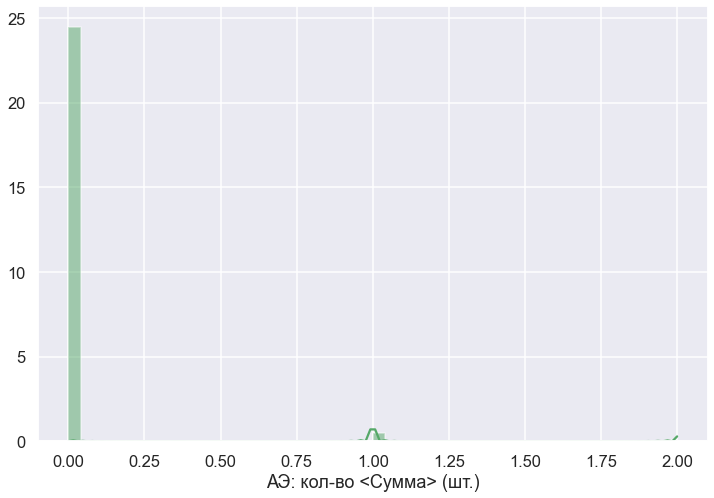

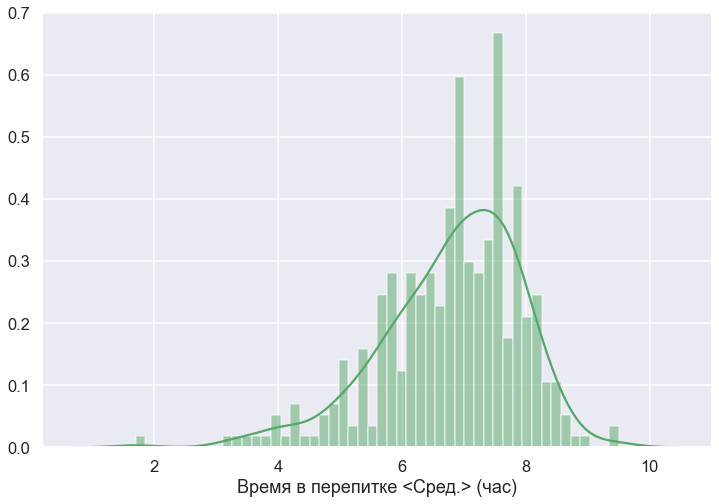

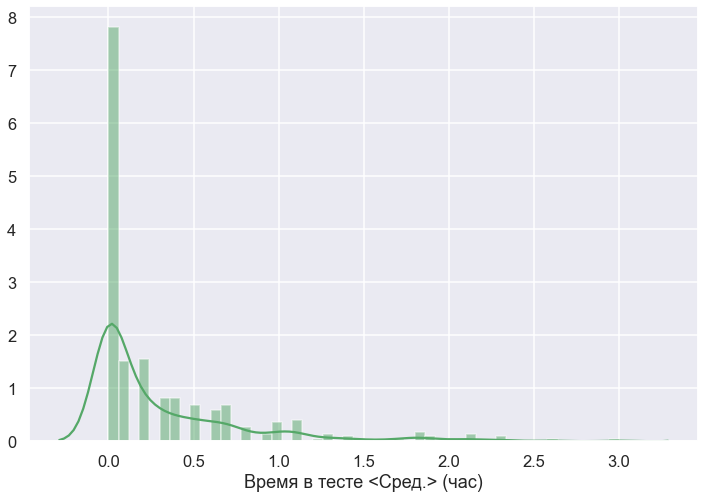

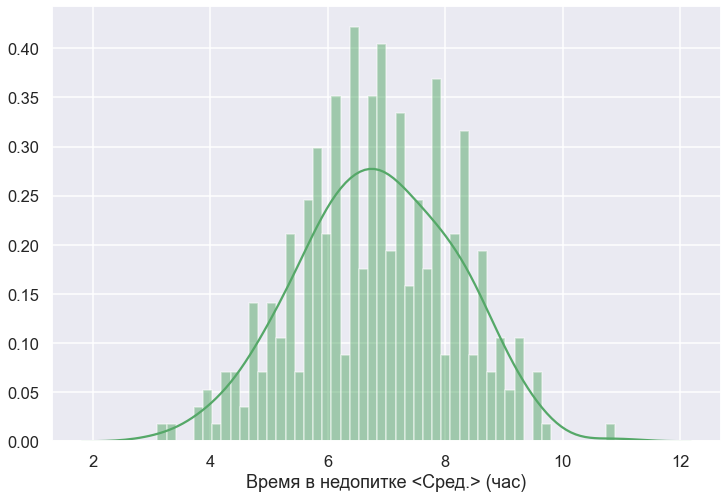

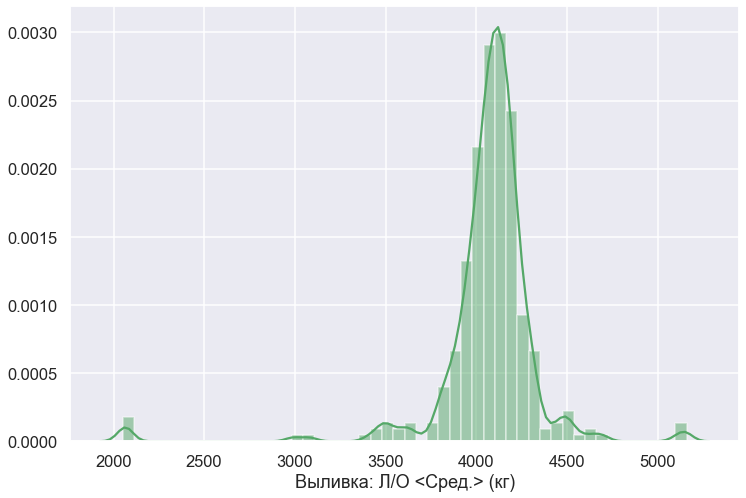

...

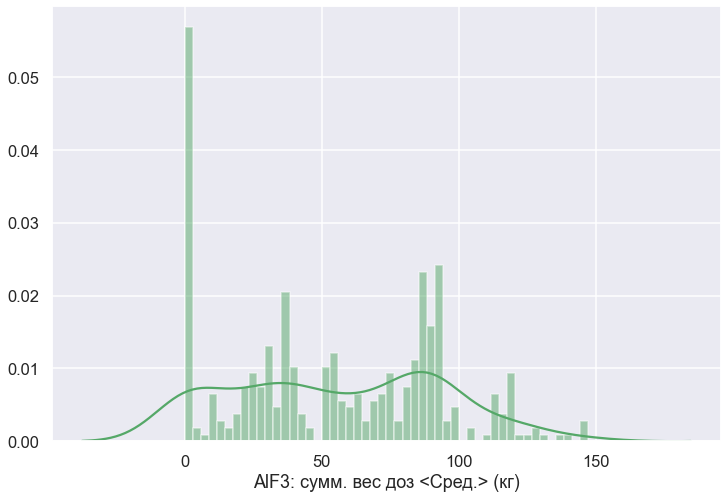

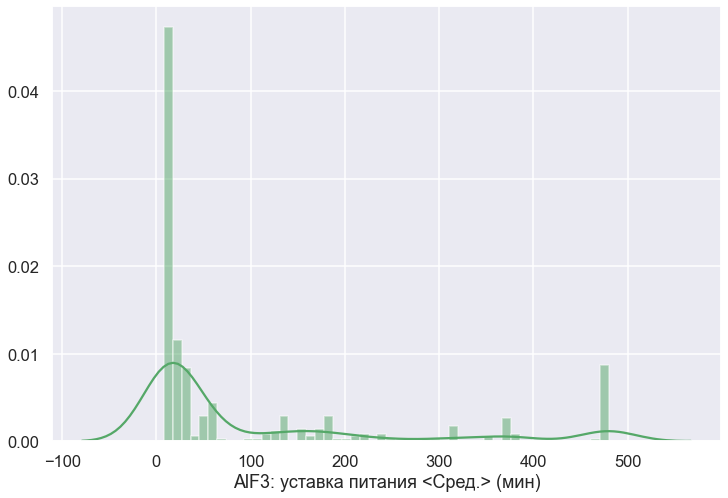

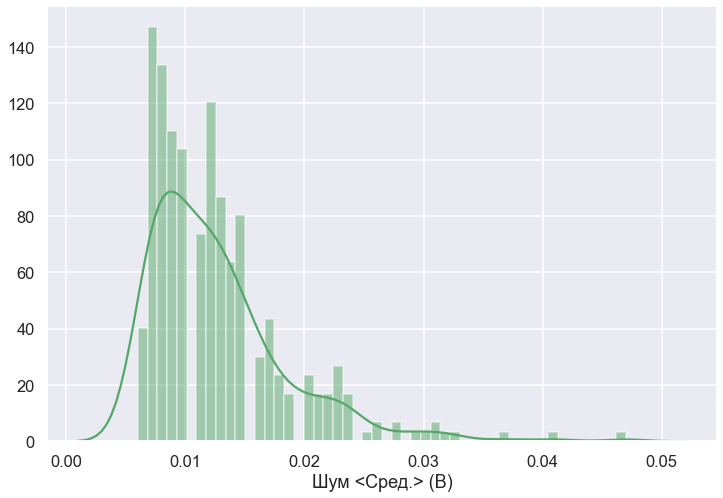

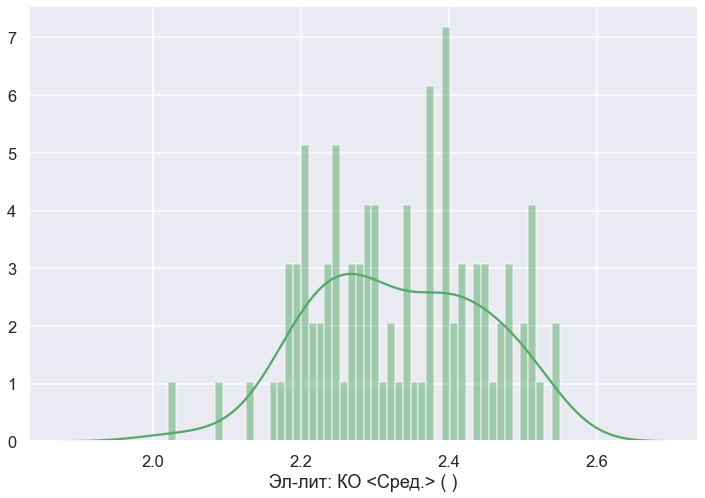

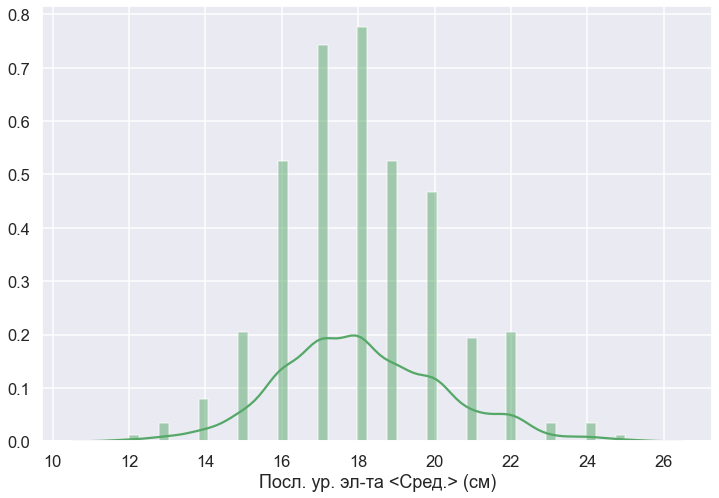

In [ ]:
# draw distributions
for i in range(columnsNumber):
    drawHistograms(raw, columnNames[i], paramNames[i])

# нормализация данных

In [ ]:
# normalize [0,1]
scaler = preprocessing.MinMaxScaler()
x_scaled = scaler.fit_transform(raw)
dataScaled = pd.DataFrame(x_scaled)
dataScaled.columns=columnNames
dataScaled.head()


,AE,TIME1,TIME2,TIME3,POURING,OUT1,OUT2,OUT3,APG1,APG2,...,TEMP,TLIQ,MET,FRP1,FRP2,ALF1,ALF2,NOISE,KO,LEVEL
0,0.0,0.192308,0.000000,0.038462,0.646302,0.804688,0.804688,0.804422,0.102791,0.778449,...,0.413043,0.639344,0.666667,NaN,NaN,0.775510,0.004237,0.292683,NaN,NaN
1,0.0,0.320513,0.133333,0.576923,0.630225,0.804688,0.804688,0.804422,0.584752,0.509819,...,0.260870,0.524590,0.666667,NaN,NaN,0.421769,0.400424,0.414634,0.528302,NaN
2,0.0,0.269231,0.100000,0.423077,0.678457,0.804688,0.804688,0.804422,0.437032,0.592649,...,0.543478,0.426230,0.666667,NaN,NaN,0.258503,0.648305,0.390244,NaN,NaN
3,0.0,0.282051,0.166667,0.256410,0.604502,0.804688,0.804688,0.804422,0.263445,0.687815,...,0.413043,0.442623,0.777778,NaN,NaN,0.408163,0.023305,0.439024,NaN,NaN
4,0.0,0.692308,0.000000,0.512821,0.633441,0.804688,0.804688,0.804422,0.569775,0.206949,...,0.217391,0.491803,0.888889,NaN,NaN,0.312925,0.368644,0.146341,NaN,NaN


# анализ пропусков

In [ ]:
# missing values analysis
analyzeMissingValues(raw)


Пропущенные данные (из 365 записей):
AE           0
TIME1        0
TIME2        0
TIME3        0
POURING      0
OUT1         0
OUT2         0
OUT3         0
APG1         0
APG2         0
APG3         0
APG4       166
NE           0
U1           0
RMPR1        0
RMPR2        4
RMPR3        0
RMPR4        0
RMPR5        0
I            0
TEMP         0
TLIQ         1
MET          0
FRP1       353
FRP2       353
ALF1         0
ALF2         0
NOISE        0
KO         273
LEVEL       28
dtype: int64
Пропущенные данные, % (из 365 записей):
AE          0.000000
TIME1       0.000000
TIME2       0.000000
TIME3       0.000000
POURING     0.000000
OUT1        0.000000
OUT2        0.000000
OUT3        0.000000
APG1        0.000000
APG2        0.000000
APG3        0.000000
APG4       45.479452
NE          0.000000
U1          0.000000
RMPR1       0.000000
RMPR2       1.095890
RMPR3       0.000000
RMPR4       0.000000
RMPR5       0.000000
I           0.000000
TEMP        0.000000
TLIQ        0.27397

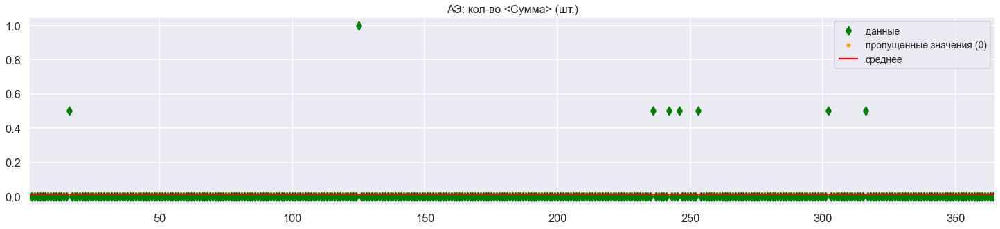

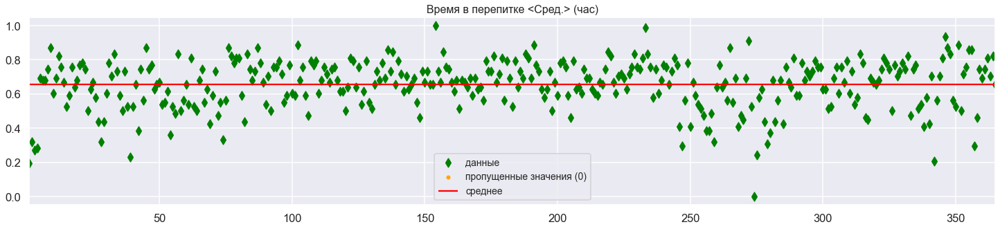

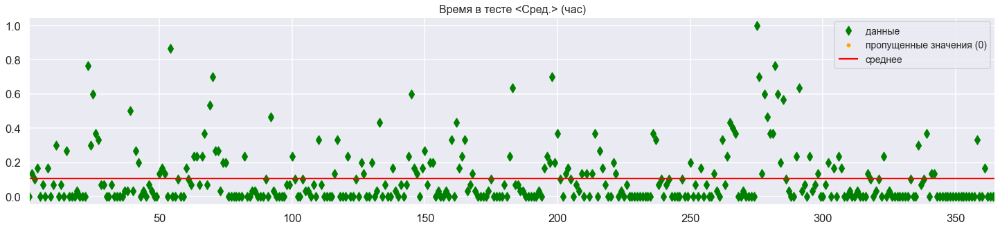

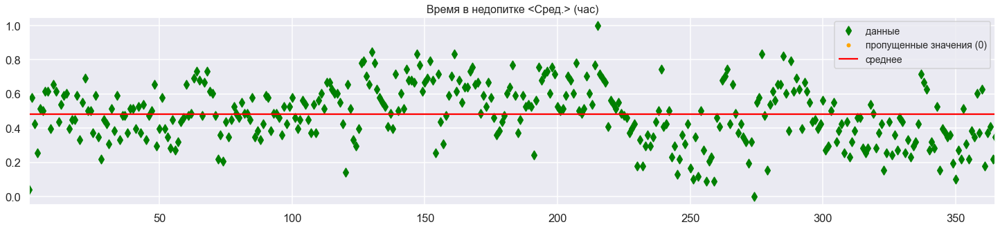

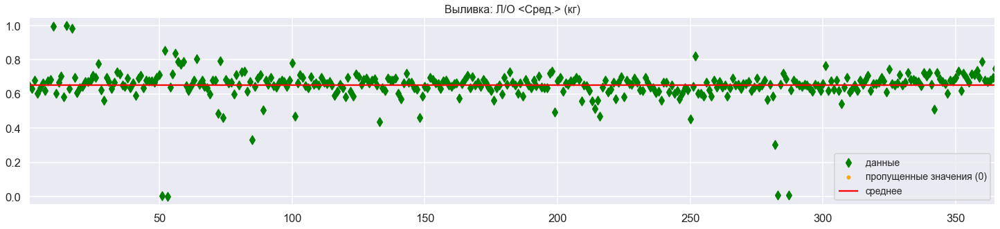

...

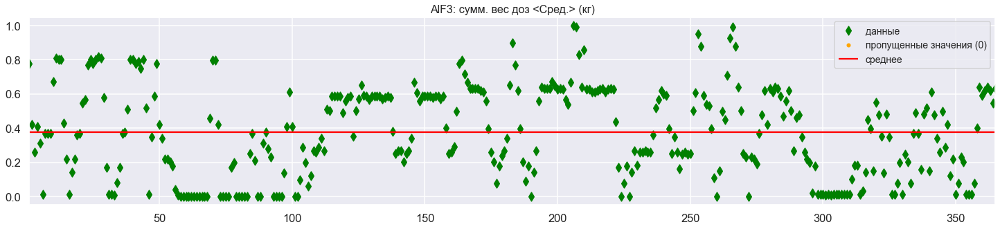

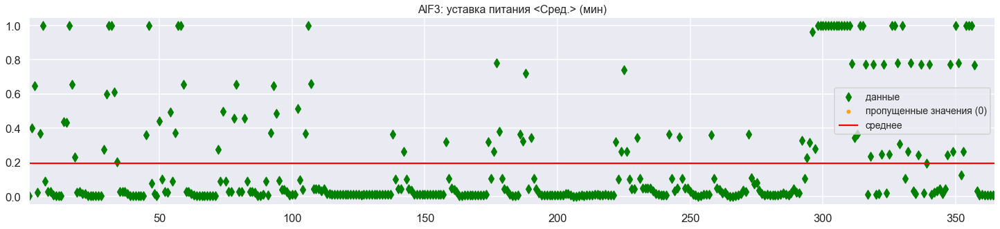

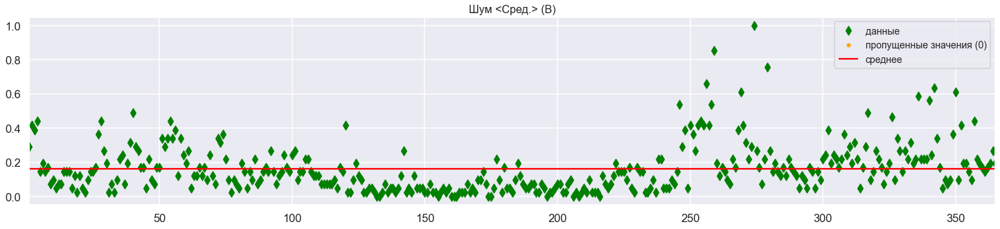

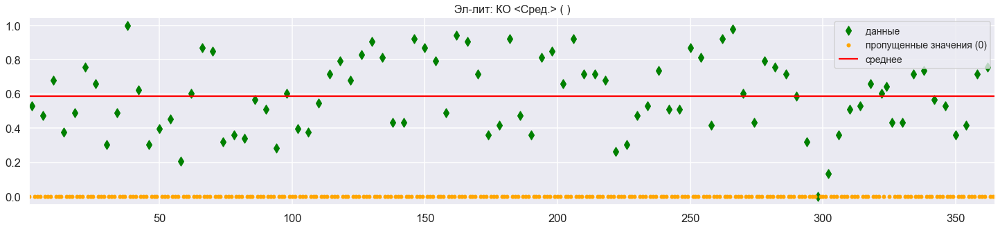

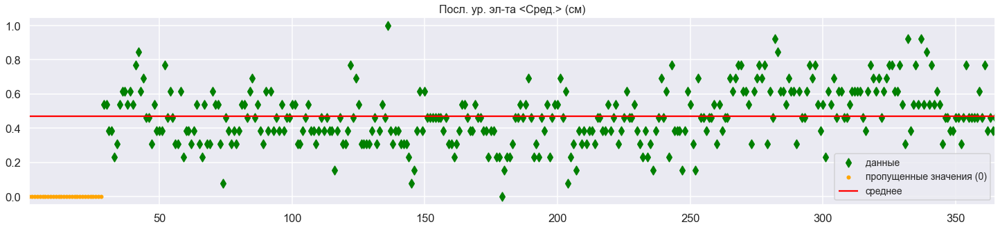

In [ ]:
# plot data
for i in range(columnsNumber):
    drawColumnAsTimeSeries(dataScaled, columnNames[i], paramNames[i])


# Заполнение интерполяцией

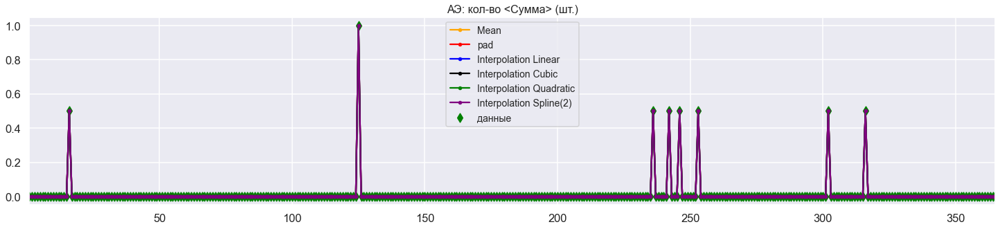

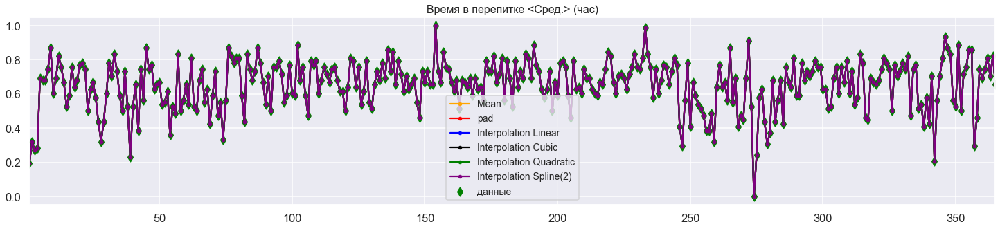

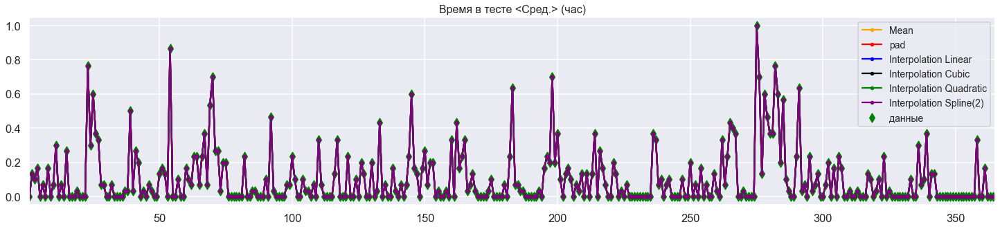

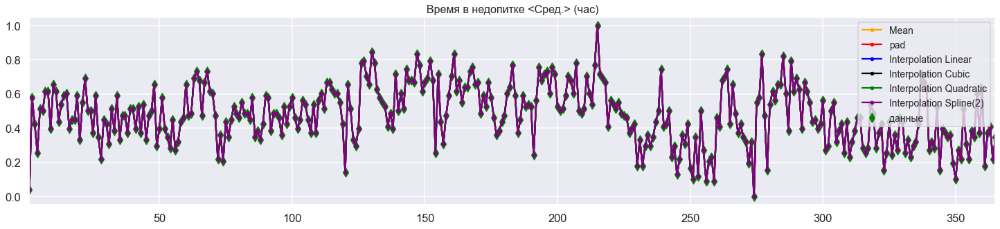

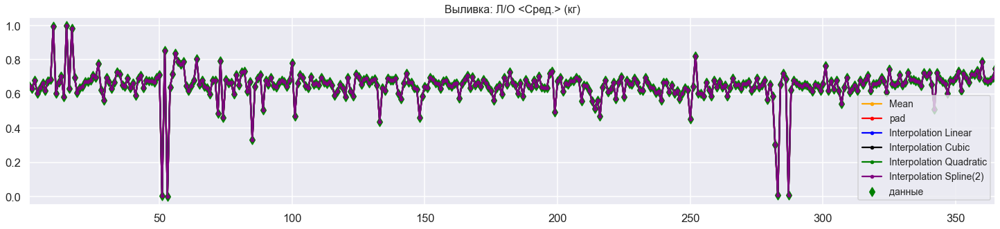

...

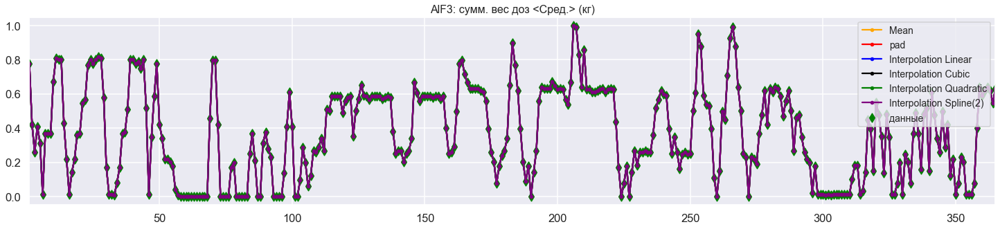

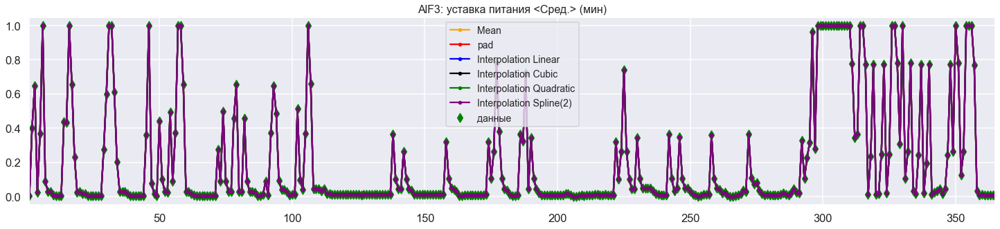

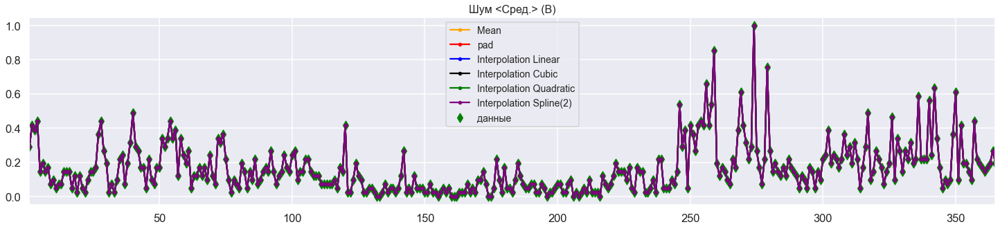

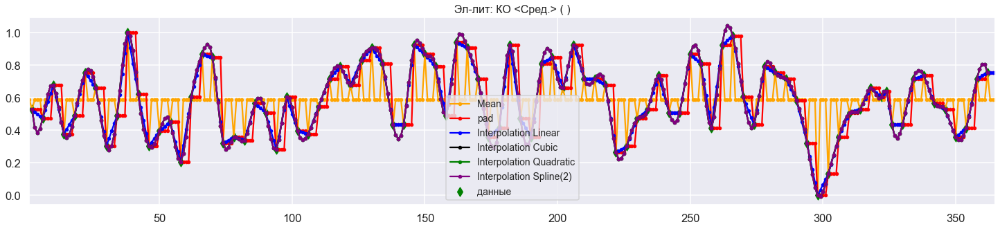

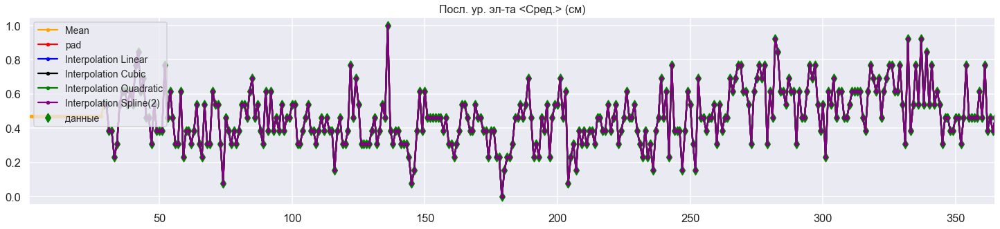

In [ ]:
# plot data with interpolations
for i in range(columnsNumber):
    drawFillNan(dataScaled,columnNames[i],paramNames[i])


# Корреляционный анализ

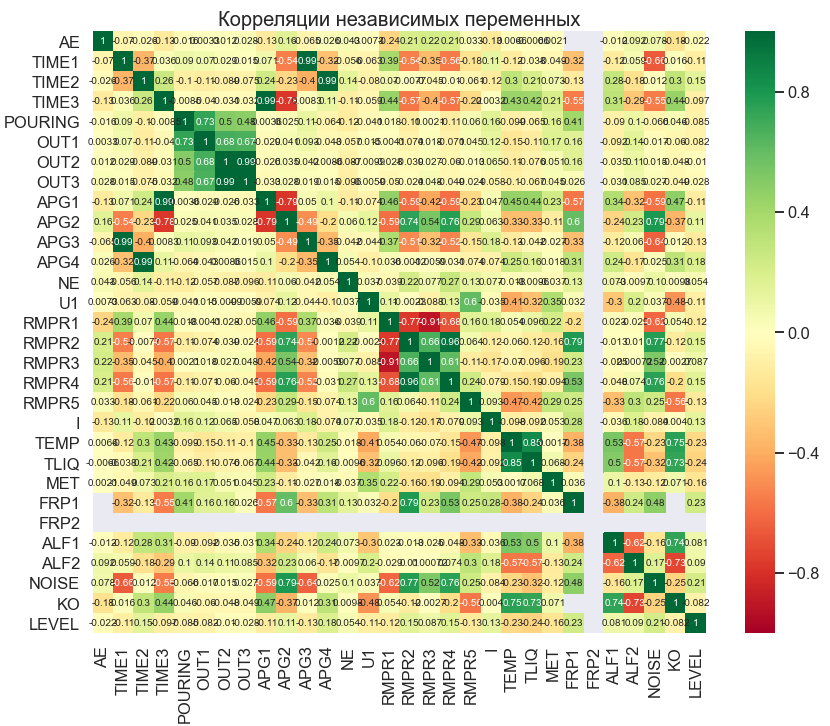

In [ ]:
# plot correlation analysis
drawCorrMatrix(dataScaled)
# drawCorrMatrix(dataScaled, ['TEMP','KO'])

In [ ]:
analyzeCorrWithTargets(dataScaled,outputNames)


#################################################
###### Корреляция с целевыми переменными   ######
#################################################

Корреляция с переменной &#39; TEMP &#39;:


TLIQ       0.852228
ALF1       0.532301
APG1       0.446643
TIME3      0.432887
TIME2      0.302591
APG4       0.249743
RMPR1      0.054020
AE         0.006554
MET        0.001725
NE        -0.017810
RMPR2     -0.060275
RMPR3     -0.069808
I         -0.098100
POURING   -0.098677
OUT3      -0.101211
OUT2      -0.112864
TIME1     -0.117354
APG3      -0.126494
OUT1      -0.148638
RMPR4     -0.148661
LEVEL     -0.225583
NOISE     -0.233990
APG2      -0.330341
FRP1      -0.379546
U1        -0.408541
RMPR5     -0.474474
ALF2      -0.568253
FRP2            NaN
Name: TEMP, dtype: float64

-------------------------------------------------
Корреляции больше заданного порога ( 0.3 ) с переменной TEMP :


TLIQ     0.852228
ALF1     0.532301
APG1     0.446643
TIME3    0.432887
TIME2    0.302591
APG2    -0.330341
FRP1    -0.379546
U1      -0.408541
RMPR5   -0.474474
ALF2    -0.568253
Name: TEMP, dtype: float64

-------------------------------------------------

Корреляция с переменной &#39; KO &#39;:


ALF1       0.740168
TLIQ       0.729438
APG1       0.471196
TIME3      0.439295
APG4       0.306274
TIME2      0.296044
MET        0.070674
RMPR1      0.053622
POURING    0.046322
TIME1      0.015974
APG3       0.012485
NE         0.009836
I          0.003975
RMPR3     -0.002704
OUT2      -0.047594
OUT3      -0.049462
OUT1      -0.059728
LEVEL     -0.081901
RMPR2     -0.118238
AE        -0.175568
RMPR4     -0.202197
NOISE     -0.247426
APG2      -0.367315
U1        -0.477838
RMPR5     -0.563909
ALF2      -0.728458
FRP1            NaN
FRP2            NaN
Name: KO, dtype: float64

-------------------------------------------------
Корреляции больше заданного порога ( 0.3 ) с переменной KO :


ALF1     0.740168
TLIQ     0.729438
APG1     0.471196
TIME3    0.439295
APG4     0.306274
APG2    -0.367315
U1      -0.477838
RMPR5   -0.563909
ALF2    -0.728458
Name: KO, dtype: float64

-------------------------------------------------


# Графики парных зависимостей

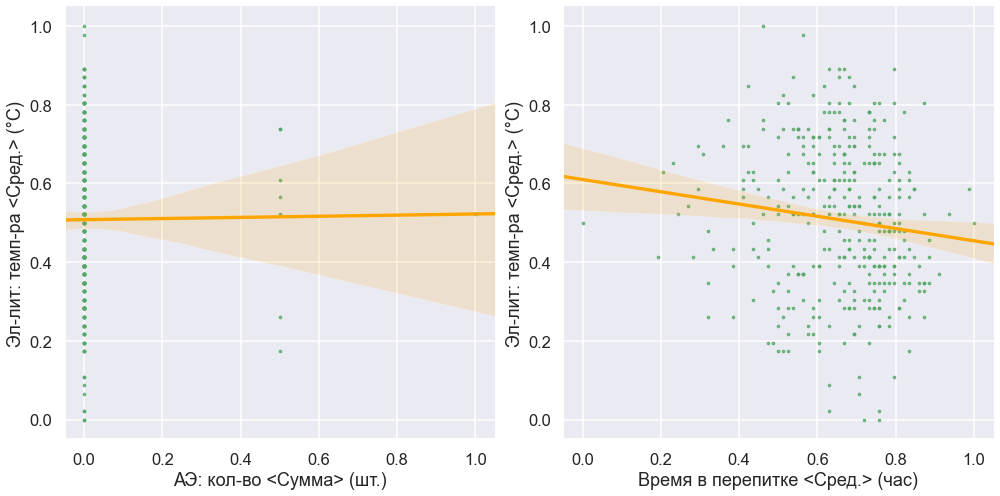

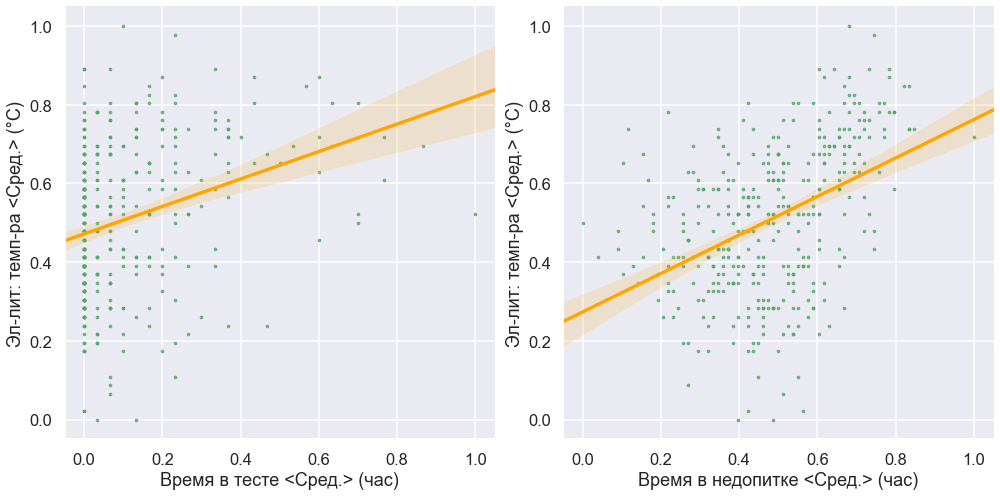

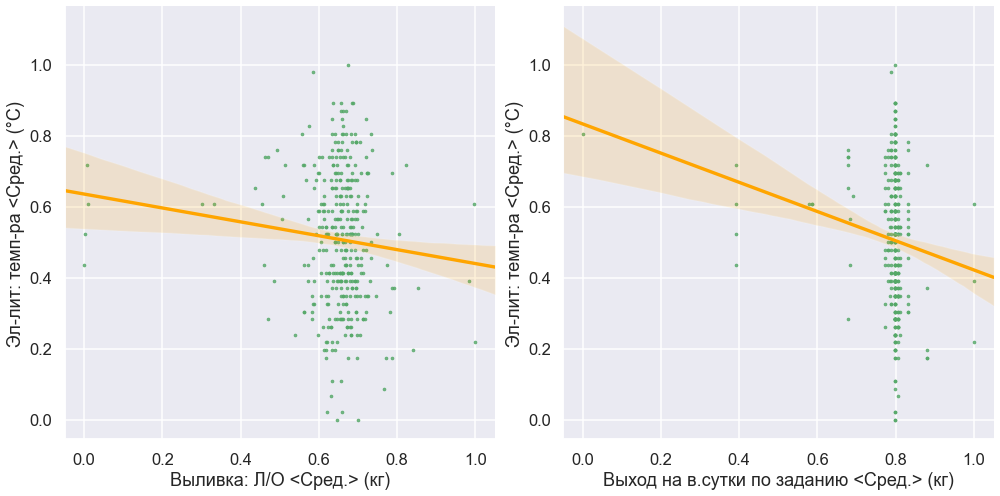

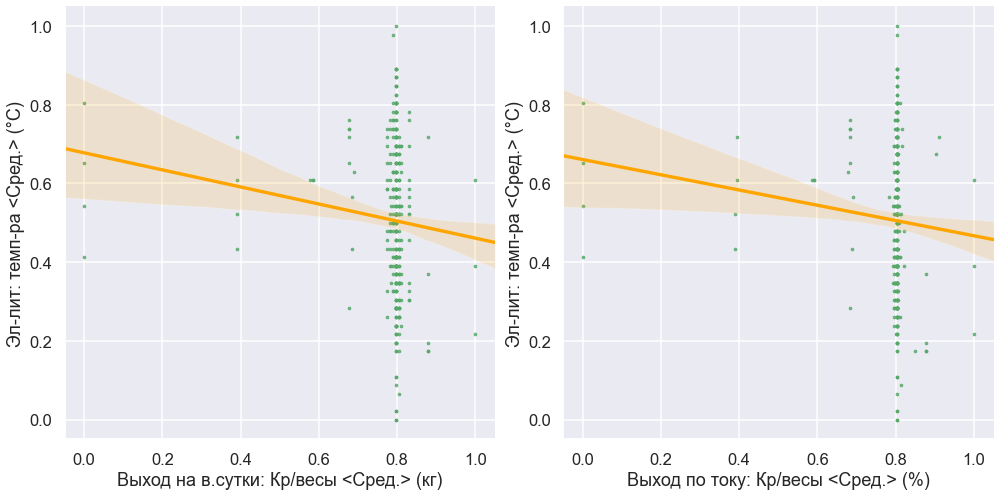

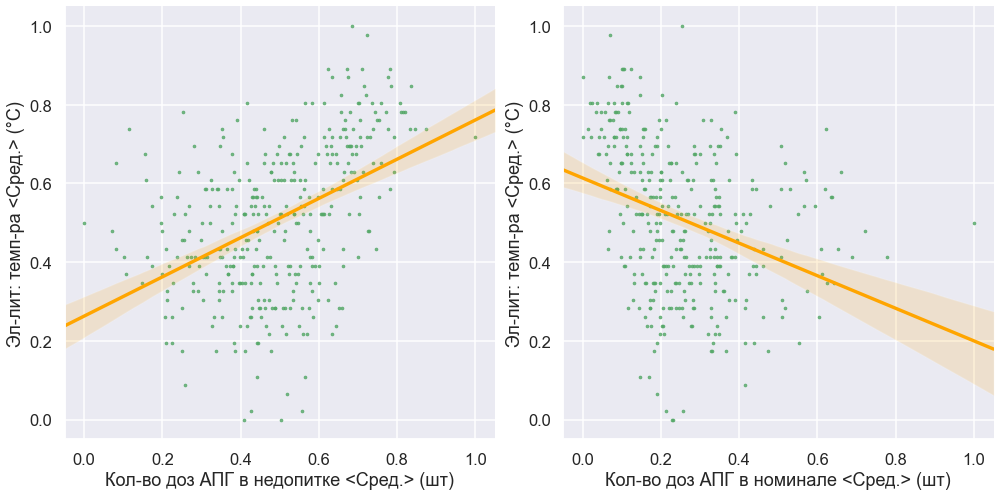

...

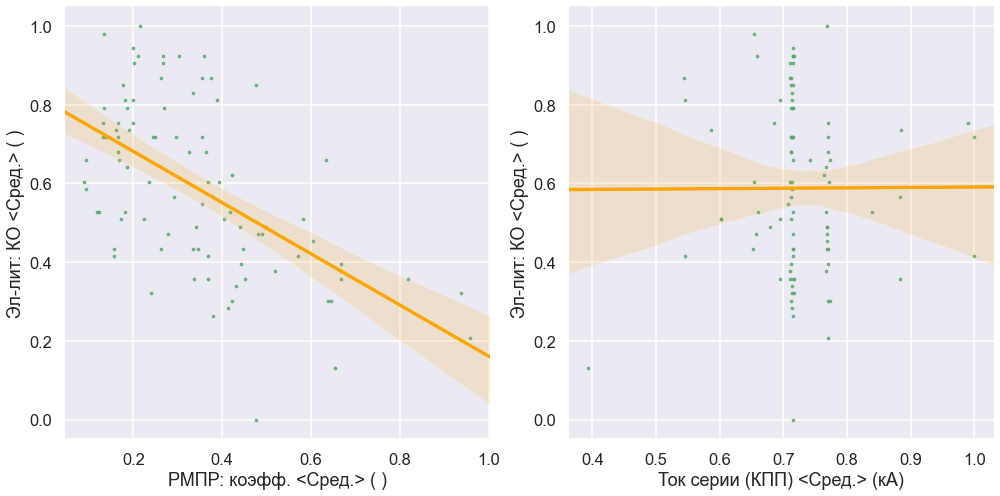

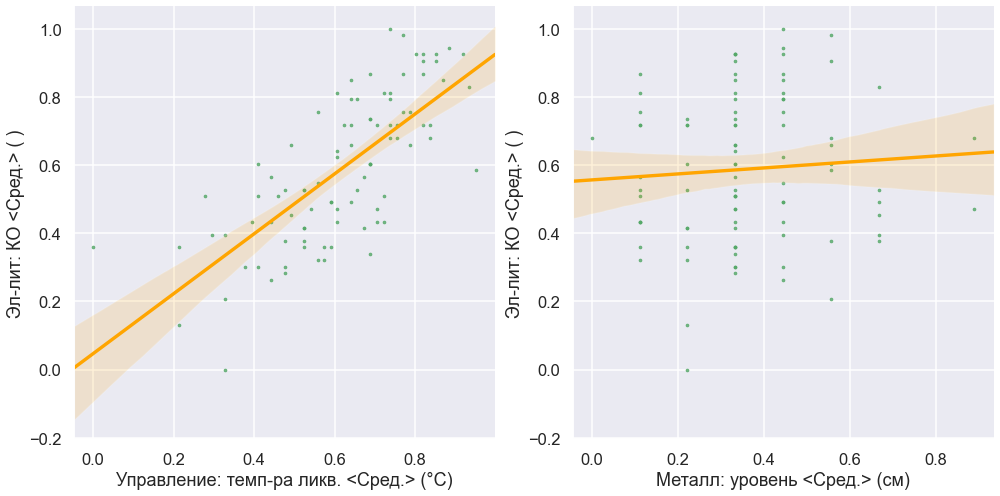

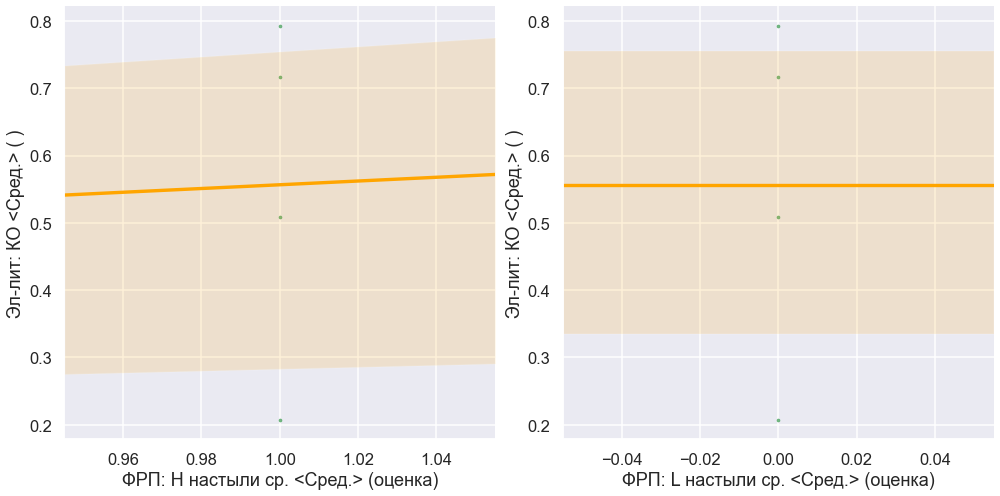

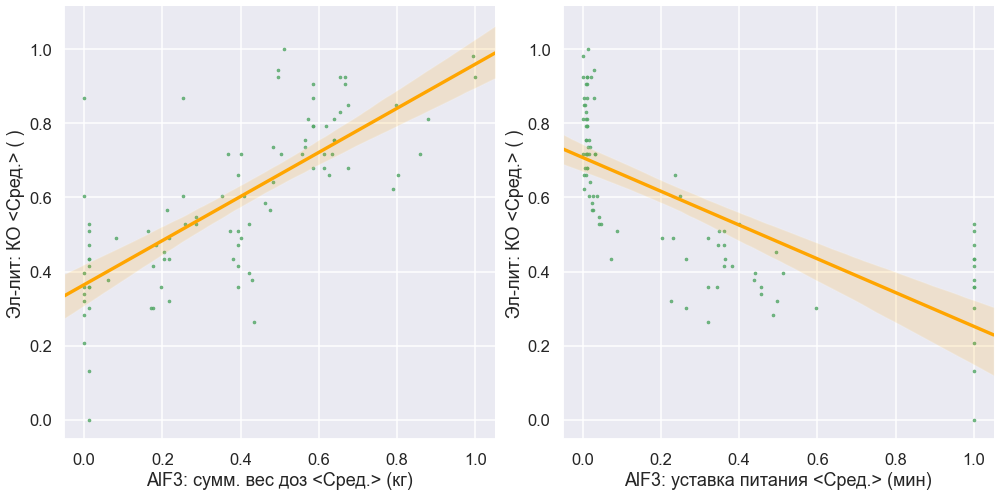

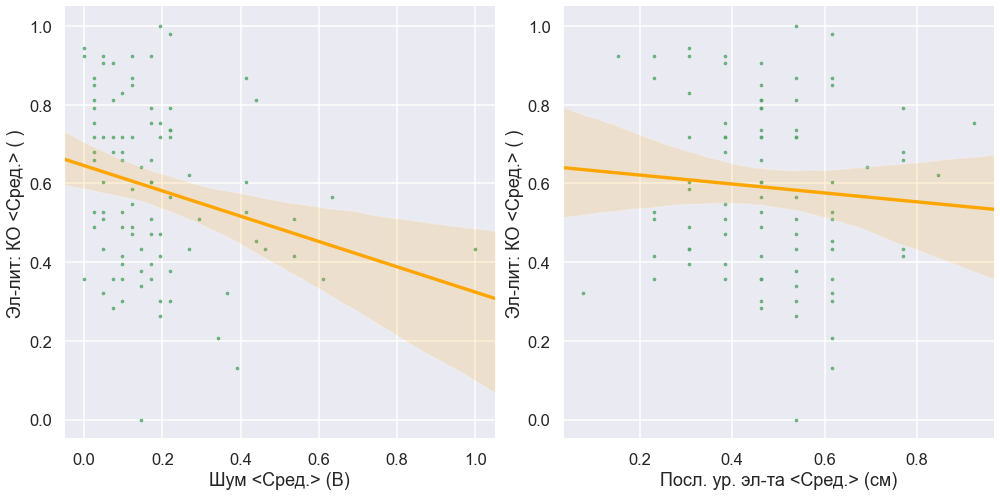

In [ ]:
# pair plots
drawPairPlots(dataScaled,inputNames, outputNames, paramNamesDictionary)


# Используем линейную интерполяцию для построения моделей

In [ ]:
# lets use liniear interpolation for scalled data
for col in dataScaled.columns:
    if np.isnan(dataScaled.loc[0, col]):
        dataScaled.loc[0, col] = dataScaled[col].mean()
data=dataScaled.interpolate(method='linear').copy()
data.head()


,AE,TIME1,TIME2,TIME3,POURING,OUT1,OUT2,OUT3,APG1,APG2,...,TEMP,TLIQ,MET,FRP1,FRP2,ALF1,ALF2,NOISE,KO,LEVEL
0,0.0,0.192308,0.000000,0.038462,0.646302,0.804688,0.804688,0.804422,0.102791,0.778449,...,0.413043,0.639344,0.666667,0.850000,0.0,0.775510,0.004237,0.292683,0.588187,0.468614
1,0.0,0.320513,0.133333,0.576923,0.630225,0.804688,0.804688,0.804422,0.584752,0.509819,...,0.260870,0.524590,0.666667,0.855556,0.0,0.421769,0.400424,0.414634,0.528302,0.471109
2,0.0,0.269231,0.100000,0.423077,0.678457,0.804688,0.804688,0.804422,0.437032,0.592649,...,0.543478,0.426230,0.666667,0.861111,0.0,0.258503,0.648305,0.390244,0.514151,0.473604
3,0.0,0.282051,0.166667,0.256410,0.604502,0.804688,0.804688,0.804422,0.263445,0.687815,...,0.413043,0.442623,0.777778,0.866667,0.0,0.408163,0.023305,0.439024,0.500000,0.476098
4,0.0,0.692308,0.000000,0.512821,0.633441,0.804688,0.804688,0.804422,0.569775,0.206949,...,0.217391,0.491803,0.888889,0.872222,0.0,0.312925,0.368644,0.146341,0.485849,0.478593


# МГК

In [ ]:
# PCA plots
pca1=PCA()
pcaData1=pca1.fit_transform(data[inputNames])
print(np.array_str(pca1.explained_variance_ratio_*100, precision=2, suppress_small=True))


[29.35 18.53  8.65  7.12  6.66  4.44  4.23  3.6   2.86  2.63  2.21  1.8
  1.33  1.25  1.1   0.95  0.87  0.8   0.57  0.45  0.18  0.17  0.12  0.08
  0.03  0.02  0.    0.  ]


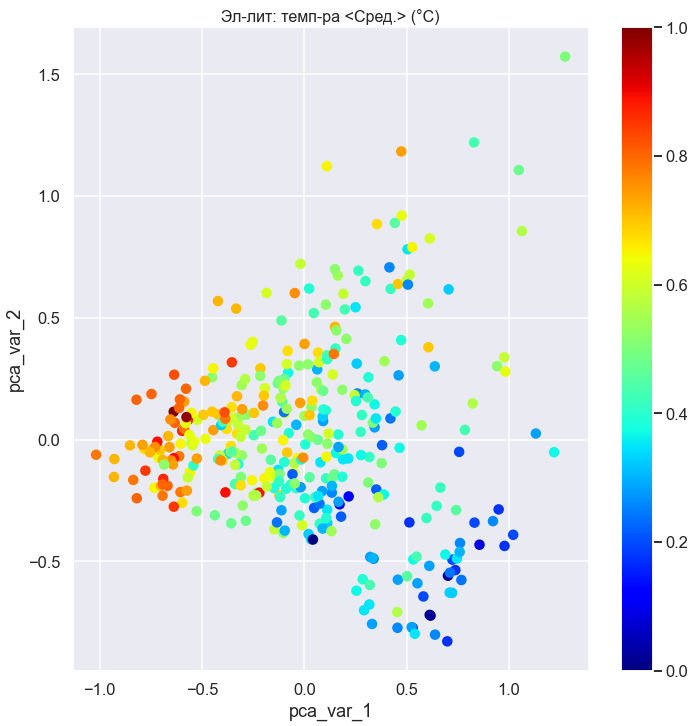

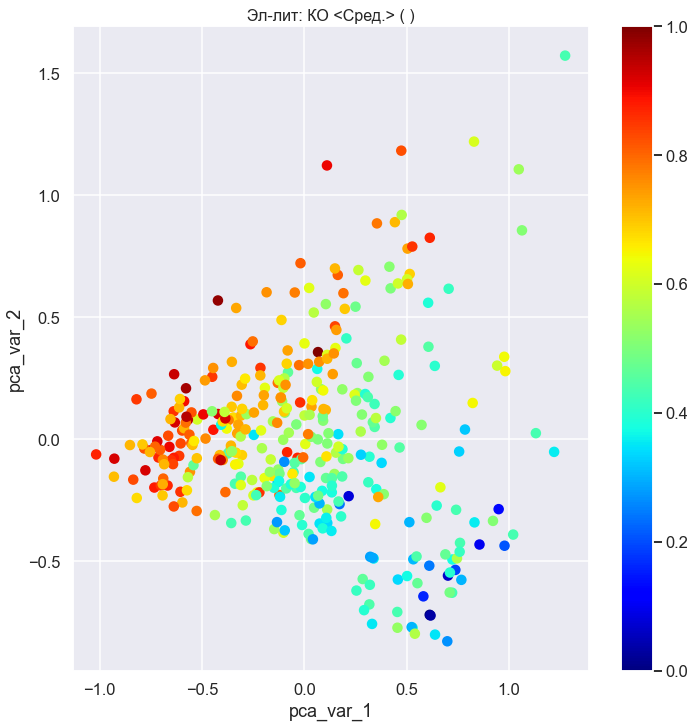

In [ ]:
# draw flat pca plot
drawPCAFlatPlot(pcaData1,data,outputNames,paramNamesDictionary)


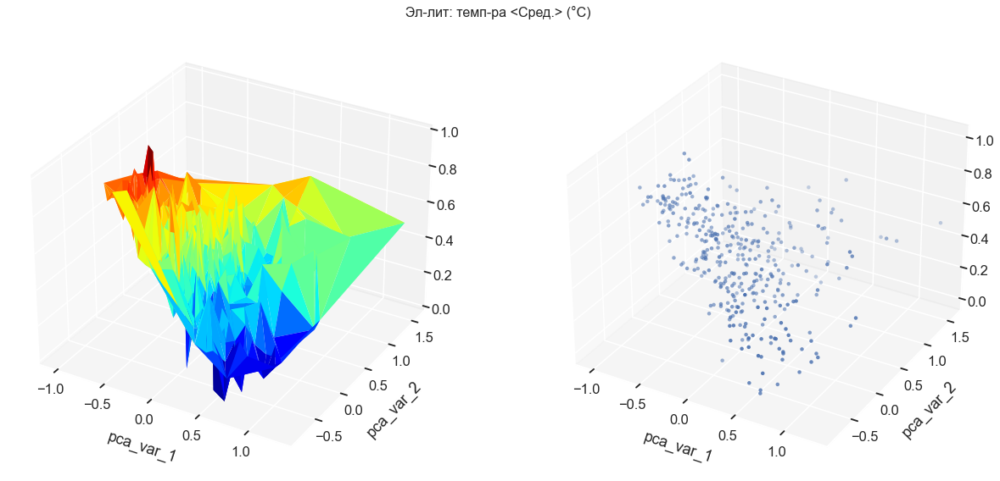

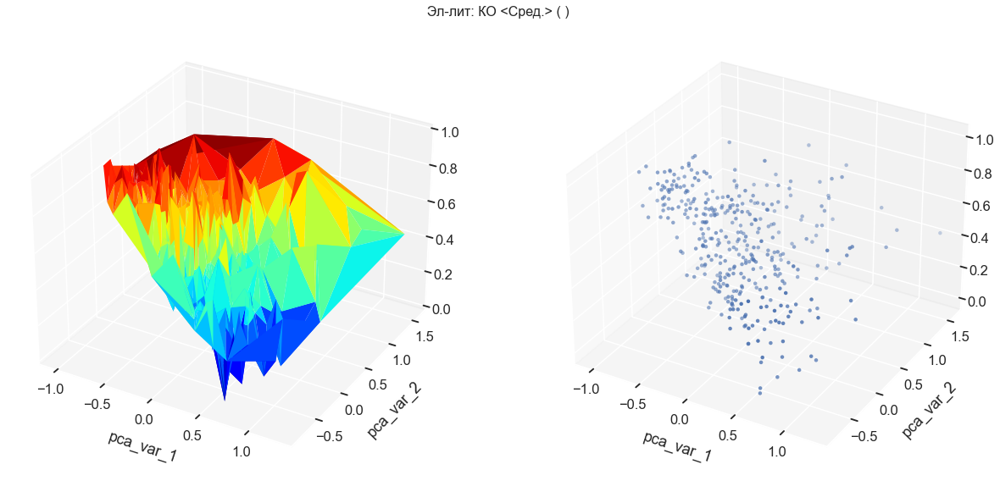

In [ ]:
# draw flat pca plot
drawPCA3DPlot(pcaData1,data,outputNames,paramNamesDictionary)


# Построение линейной модели

In [ ]:
# lin models for TEMP with inputs excluding 2nd out
rezults1=analyzeLinModels(data,inputNames, outputNames[0], paramNamesDictionary)
rezults1


,best,mean,std,median,worst
mse,0.072805,0.098995,0.035317,0.094450,0.314731
r2Score,0.864552,0.701789,0.341668,0.758873,-1.412046
mae,0.053608,0.071967,0.009765,0.070899,0.122994


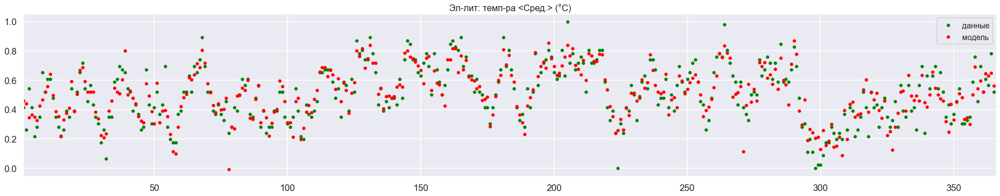

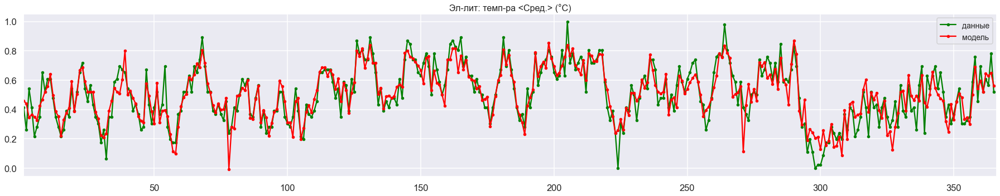

{&#39;mse&#39;: 0.0831357628514629, &#39;r2score&#39;: 0.809012381858295, &#39;mae&#39;: 0.06341004799658805}


,Переменная,Coefficients
0,AE,9.388903e-02
1,TIME1,-1.189328e-02
2,TIME2,4.551620e-02
3,TIME3,5.722632e-01
4,POURING,2.381112e-02
5,OUT1,-3.929771e-02
6,OUT2,-4.583685e+00
7,OUT3,4.491376e+00
8,APG1,-5.295930e-01
9,APG2,-1.453573e-01


In [ ]:
modelPErformance1, coef1 = buildLinModels(data,inputNames, outputNames[0], paramNamesDictionary, drawRez=True)
print(modelPErformance1)
coef1


In [ ]:
# lin models for TEMP with inputs including 2nd out
inCols=inputNames.copy()
inCols.append(outputNames[1])
rezults2=analyzeLinModels(data, inCols, outputNames[0], paramNamesDictionary)
rezults2

,best,mean,std,median,worst
mse,0.071612,0.119590,0.196575,0.088656,1.346373
r2Score,0.843879,-0.564517,8.370702,0.777823,-52.838931
mae,0.056888,0.072949,0.038006,0.067680,0.307553


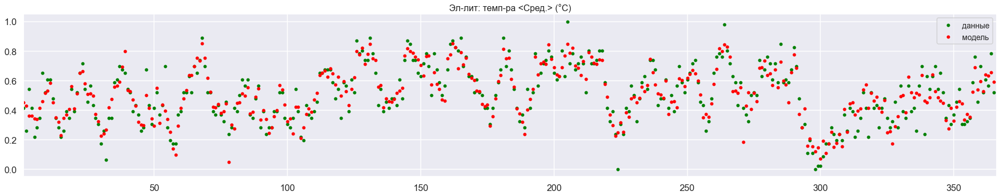

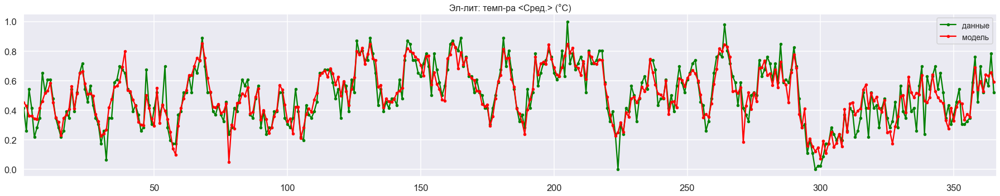

{&#39;mse&#39;: 0.07753762664946283, &#39;r2score&#39;: 0.8338675586288797, &#39;mae&#39;: 0.05926457950071828}


,Переменная,Coefficients
0,AE,9.178786e-02
1,TIME1,2.428387e-01
2,TIME2,4.898213e-02
3,TIME3,5.042464e-01
4,POURING,1.637297e-02
5,OUT1,-9.070665e-02
6,OUT2,-8.615010e+00
7,OUT3,8.536846e+00
8,APG1,-4.529547e-01
9,APG2,-6.349354e-02


In [ ]:
modelPErformance2, coef2 = buildLinModels(data, inCols, outputNames[0], paramNamesDictionary, drawRez=True)
print(modelPErformance2)
coef2

In [ ]:
# lin models for KO with inputs excluding 2nd out
rezults3=analyzeLinModels(data,inputNames, outputNames[1], paramNamesDictionary)
rezults3


,best,mean,std,median,worst
mse,0.095535,0.122539,0.052210,0.115152,0.444732
r2Score,0.735365,0.488534,0.939288,0.638544,-5.367720
mae,0.074263,0.091123,0.013108,0.088957,0.161629


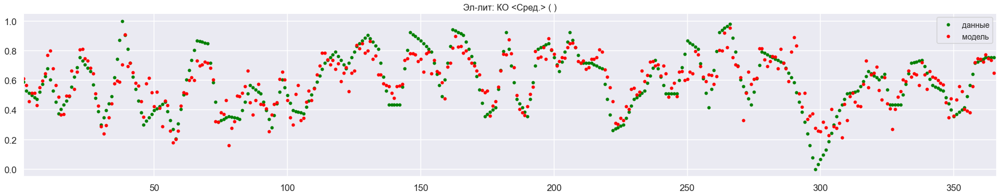

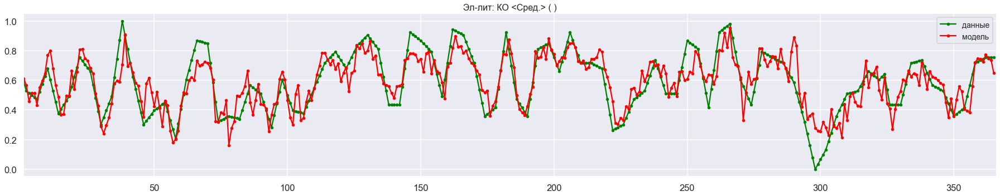

{&#39;mse&#39;: 0.10119351922233791, &#39;r2score&#39;: 0.724457541621955, &#39;mae&#39;: 0.07874691636096698}


,Переменная,Coefficients
0,AE,7.089575e-03
1,TIME1,-8.594931e-01
2,TIME2,-1.169443e-02
3,TIME3,2.294962e-01
4,POURING,2.509713e-02
5,OUT1,1.734593e-01
6,OUT2,1.360213e+01
7,OUT3,-1.364985e+01
8,APG1,-2.585860e-01
9,APG2,-2.762172e-01


In [ ]:
modelPErformance3, coef3 = buildLinModels(data,inputNames, outputNames[1], paramNamesDictionary, drawRez=True)
print(modelPErformance3)
coef3


In [ ]:
# lin models for KO with inputs including 2nd out
inCols=inputNames.copy()
inCols.append(outputNames[0])
rezults4=analyzeLinModels(data,inCols, outputNames[1], paramNamesDictionary)
rezults4


,best,mean,std,median,worst
mse,0.090095,0.107031,0.007878,0.107177,0.123896
r2Score,0.794604,0.692284,0.043119,0.701412,0.592164
mae,0.071768,0.084623,0.005867,0.085501,0.097750


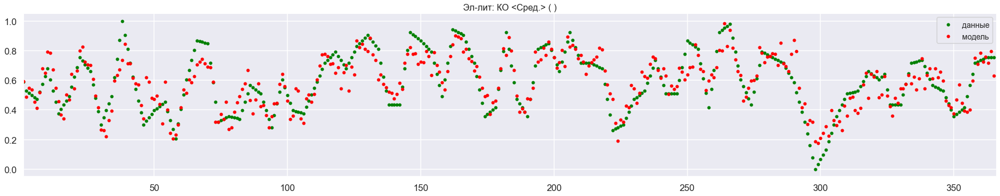

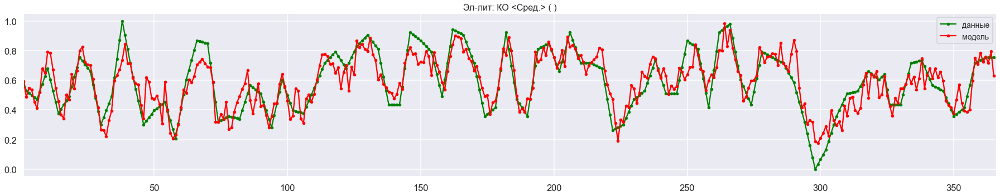

{&#39;mse&#39;: 0.09437942281020162, &#39;r2score&#39;: 0.7603167066161298, &#39;mae&#39;: 0.0747503577156328}


,Переменная,Coefficients
0,AE,-3.413778e-02
1,TIME1,-8.542707e-01
2,TIME2,-3.168092e-02
3,TIME3,-2.178875e-02
4,POURING,1.464149e-02
5,OUT1,1.907152e-01
6,OUT2,1.561486e+01
7,OUT3,-1.562205e+01
8,APG1,-2.603784e-02
9,APG2,-2.123897e-01


In [ ]:
modelPErformance4, coef4 = buildLinModels(data,inCols, outputNames[1], paramNamesDictionary, drawRez=True)
print(modelPErformance4)
coef4


# Построение нелинейной модели (SVR)

In [ ]:
# SVR models for TEMP with inputs excluding 2nd out
rezults1_=analyzeSVRModels(data,inputNames, outputNames[0], paramNamesDictionary)
rezults1_


--------------------------------------------
SVR model analysis starts.
Run 1 from 40
Run 2 from 40
Run 3 from 40
Run 4 from 40
Run 5 from 40
Run 6 from 40
Run 7 from 40
Run 8 from 40
Run 9 from 40
Run 10 from 40
Run 11 from 40
Run 12 from 40
Run 13 from 40
Run 14 from 40
Run 15 from 40
Run 16 from 40
Run 17 from 40
Run 18 from 40
Run 19 from 40
Run 20 from 40
Run 21 from 40
Run 22 from 40
Run 23 from 40
Run 24 from 40
Run 25 from 40
Run 26 from 40
Run 27 from 40
Run 28 from 40
Run 29 from 40
Run 30 from 40
Run 31 from 40
Run 32 from 40
Run 33 from 40
Run 34 from 40
Run 35 from 40
Run 36 from 40
Run 37 from 40
Run 38 from 40
Run 39 from 40
Run 40 from 40
All runs are done.


,best,mean,std,median,worst
mse,0.076730,0.089082,0.006195,0.088699,0.102637
r2Score,0.837076,0.775379,0.034172,0.774865,0.708803
mae,0.060259,0.068452,0.004595,0.068389,0.080757


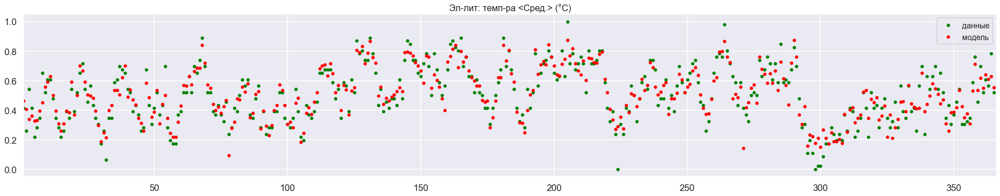

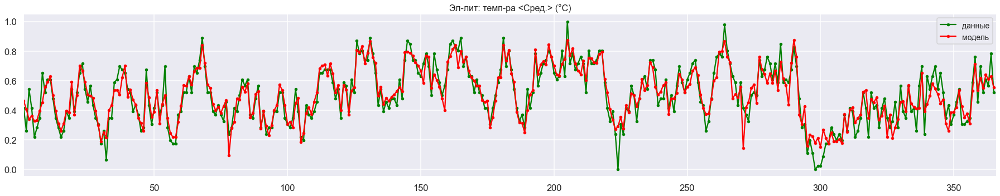

{&#39;mse&#39;: 0.07219531885290198, &#39;r2score&#39;: 0.8559718050927079, &#39;mae&#39;: 0.05600787696259981}


SVR(C=0.5, cache_size=200, coef0=0.0, degree=3, epsilon=0.05, gamma=&#39;scale&#39;,
    kernel=&#39;rbf&#39;, max_iter=-1, shrinking=True, tol=0.001, verbose=False)

In [ ]:
modelPErformance1_, coef1_ = buildSVRModels(data,inputNames, outputNames[0], paramNamesDictionary, drawRez=True)
print(modelPErformance1_)
coef1_


In [ ]:
# SVR models for TEMP with inputs including 2nd out
inCols=inputNames.copy()
inCols.append(outputNames[1])
rezults2_=analyzeSVRModels(data,inCols, outputNames[0], paramNamesDictionary)
rezults2_


--------------------------------------------
SVR model analysis starts.
Run 1 from 40
Run 2 from 40
Run 3 from 40
Run 4 from 40
Run 5 from 40
Run 6 from 40
Run 7 from 40
Run 8 from 40
Run 9 from 40
Run 10 from 40
Run 11 from 40
Run 12 from 40
Run 13 from 40
Run 14 from 40
Run 15 from 40
Run 16 from 40
Run 17 from 40
Run 18 from 40
Run 19 from 40
Run 20 from 40
Run 21 from 40
Run 22 from 40
Run 23 from 40
Run 24 from 40
Run 25 from 40
Run 26 from 40
Run 27 from 40
Run 28 from 40
Run 29 from 40
Run 30 from 40
Run 31 from 40
Run 32 from 40
Run 33 from 40
Run 34 from 40
Run 35 from 40
Run 36 from 40
Run 37 from 40
Run 38 from 40
Run 39 from 40
Run 40 from 40
All runs are done.


,best,mean,std,median,worst
mse,0.070955,0.086292,0.006749,0.086364,0.103293
r2Score,0.862232,0.791596,0.034247,0.798046,0.690754
mae,0.052767,0.066191,0.006068,0.066131,0.079314


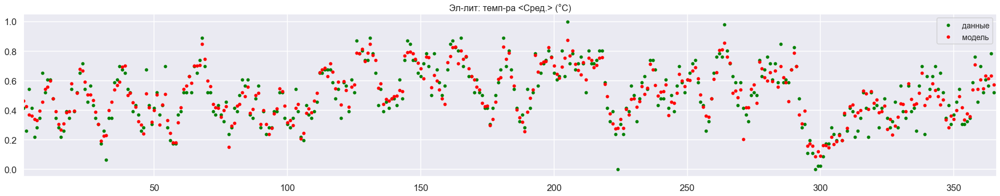

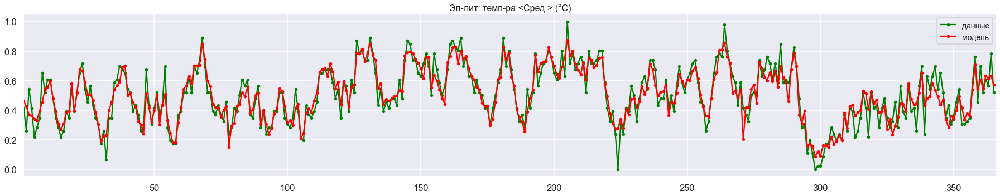

{&#39;mse&#39;: 0.06828004361266247, &#39;r2score&#39;: 0.8711699961399553, &#39;mae&#39;: 0.05294100088605549}


SVR(C=0.5, cache_size=200, coef0=0.0, degree=3, epsilon=0.05, gamma=&#39;scale&#39;,
    kernel=&#39;rbf&#39;, max_iter=-1, shrinking=True, tol=0.001, verbose=False)

In [ ]:
modelPErformance2_, coef2_ = buildSVRModels(data ,inCols, outputNames[0], paramNamesDictionary, drawRez=True)
print(modelPErformance2_)
coef2_

In [ ]:
# SVR models for KO  with inputs excluding 2nd out
rezults3_=analyzeSVRModels(data,inputNames, outputNames[1], paramNamesDictionary)
rezults3_

--------------------------------------------
SVR model analysis starts.
Run 1 from 40
Run 2 from 40
Run 3 from 40
Run 4 from 40
Run 5 from 40
Run 6 from 40
Run 7 from 40
Run 8 from 40
Run 9 from 40
Run 10 from 40
Run 11 from 40
Run 12 from 40
Run 13 from 40
Run 14 from 40
Run 15 from 40
Run 16 from 40
Run 17 from 40
Run 18 from 40
Run 19 from 40
Run 20 from 40
Run 21 from 40
Run 22 from 40
Run 23 from 40
Run 24 from 40
Run 25 from 40
Run 26 from 40
Run 27 from 40
Run 28 from 40
Run 29 from 40
Run 30 from 40
Run 31 from 40
Run 32 from 40
Run 33 from 40
Run 34 from 40
Run 35 from 40
Run 36 from 40
Run 37 from 40
Run 38 from 40
Run 39 from 40
Run 40 from 40
All runs are done.


,best,mean,std,median,worst
mse,0.088510,0.107361,0.008881,0.108002,0.129964
r2Score,0.774208,0.682577,0.045876,0.692603,0.571500
mae,0.067258,0.081404,0.006342,0.081431,0.098844


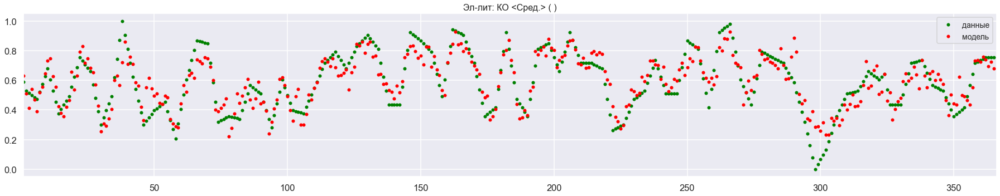

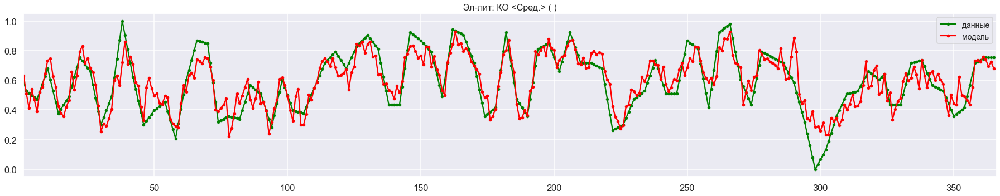

{&#39;mse&#39;: 0.09111088190104832, &#39;r2score&#39;: 0.7766306243920106, &#39;mae&#39;: 0.07247910182543243}


SVR(C=0.5, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma=&#39;scale&#39;,
    kernel=&#39;rbf&#39;, max_iter=-1, shrinking=True, tol=0.001, verbose=False)

In [ ]:
modelPErformance3_, coef3_ = buildSVRModels(data,inputNames, outputNames[1], paramNamesDictionary, drawRez=True)
print(modelPErformance3_)
coef3_

In [ ]:
inCols=inputNames.copy()
inCols.append(outputNames[0])
rezults4_=analyzeSVRModels(data,inCols, outputNames[1], paramNamesDictionary)
rezults4_

--------------------------------------------
SVR model analysis starts.
Run 1 from 40
Run 2 from 40
Run 3 from 40
Run 4 from 40
Run 5 from 40
Run 6 from 40
Run 7 from 40
Run 8 from 40
Run 9 from 40
Run 10 from 40
Run 11 from 40
Run 12 from 40
Run 13 from 40
Run 14 from 40
Run 15 from 40
Run 16 from 40
Run 17 from 40
Run 18 from 40
Run 19 from 40
Run 20 from 40
Run 21 from 40
Run 22 from 40
Run 23 from 40
Run 24 from 40
Run 25 from 40
Run 26 from 40
Run 27 from 40
Run 28 from 40
Run 29 from 40
Run 30 from 40
Run 31 from 40
Run 32 from 40
Run 33 from 40
Run 34 from 40
Run 35 from 40
Run 36 from 40
Run 37 from 40
Run 38 from 40
Run 39 from 40
Run 40 from 40
All runs are done.


,best,mean,std,median,worst
mse,0.080232,0.101991,0.008834,0.103244,0.122584
r2Score,0.806122,0.713096,0.052216,0.707998,0.589682
mae,0.061139,0.079342,0.006901,0.080577,0.092635


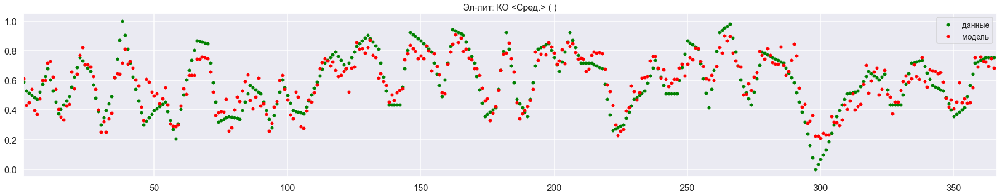

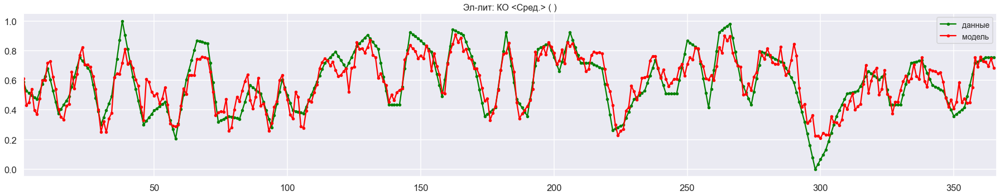

{&#39;mse&#39;: 0.08710937146452936, &#39;r2score&#39;: 0.7958201456535416, &#39;mae&#39;: 0.07102310010843672}


SVR(C=0.5, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma=&#39;scale&#39;,
    kernel=&#39;rbf&#39;, max_iter=-1, shrinking=True, tol=0.001, verbose=False)

In [ ]:
modelPErformance4_, coef4_ = buildSVRModels(data,inCols, outputNames[1], paramNamesDictionary, drawRez=True)
print(modelPErformance4_)
coef4_

# Итоговые сравнения

In [ ]:
mtrxNames=['mse','r2Score','mae']

for name in mtrxNames:
    print('Результаты для',paramNamesDictionary[outputNames[0]],'мера',name,':')
    display(pd.DataFrame( {
                        'линейная регрессия (только входы)': rezults1.T[name],
                        'линейная регрессия (входы + КО)': rezults2.T[name],
                        'SVR (только входы)': rezults1_.T[name],
                        'SVR (входы + КО)': rezults2_.T[name],
                      } ).T )
    print('')

Результаты для Эл-лит: темп-ра &lt;Сред.&gt; (°C) мера mse :


,best,mean,std,median,worst
линейная регрессия (только входы),0.072805,0.098995,0.035317,0.094450,0.314731
линейная регрессия (входы + КО),0.071612,0.119590,0.196575,0.088656,1.346373
SVR (только входы),0.076730,0.089082,0.006195,0.088699,0.102637
SVR (входы + КО),0.070955,0.086292,0.006749,0.086364,0.103293



Результаты для Эл-лит: темп-ра &lt;Сред.&gt; (°C) мера r2Score :


,best,mean,std,median,worst
линейная регрессия (только входы),0.864552,0.701789,0.341668,0.758873,-1.412046
линейная регрессия (входы + КО),0.843879,-0.564517,8.370702,0.777823,-52.838931
SVR (только входы),0.837076,0.775379,0.034172,0.774865,0.708803
SVR (входы + КО),0.862232,0.791596,0.034247,0.798046,0.690754



Результаты для Эл-лит: темп-ра &lt;Сред.&gt; (°C) мера mae :


,best,mean,std,median,worst
линейная регрессия (только входы),0.053608,0.071967,0.009765,0.070899,0.122994
линейная регрессия (входы + КО),0.056888,0.072949,0.038006,0.067680,0.307553
SVR (только входы),0.060259,0.068452,0.004595,0.068389,0.080757
SVR (входы + КО),0.052767,0.066191,0.006068,0.066131,0.079314


In [ ]:
mtrxNames=['mse','r2Score','mae']
for name in mtrxNames:
    print('Результаты для',paramNamesDictionary[outputNames[1]],'мера',name,':')
    display(pd.DataFrame( {
                        'линейная регрессия (только входы)': rezults3.T[name],
                        'линейная регрессия (входы + КО)': rezults4.T[name],
                        'SVR (только входы)': rezults3_.T[name],
                        'SVR (входы + КО)': rezults4_.T[name],
                      } ).T )
    print('')

Результаты для Эл-лит: КО &lt;Сред.&gt; ( ) мера mse :


,best,mean,std,median,worst
линейная регрессия (только входы),0.095535,0.122539,0.052210,0.115152,0.444732
линейная регрессия (входы + КО),0.090095,0.107031,0.007878,0.107177,0.123896
SVR (только входы),0.088510,0.107361,0.008881,0.108002,0.129964
SVR (входы + КО),0.080232,0.101991,0.008834,0.103244,0.122584



Результаты для Эл-лит: КО &lt;Сред.&gt; ( ) мера r2Score :


,best,mean,std,median,worst
линейная регрессия (только входы),0.735365,0.488534,0.939288,0.638544,-5.367720
линейная регрессия (входы + КО),0.794604,0.692284,0.043119,0.701412,0.592164
SVR (только входы),0.774208,0.682577,0.045876,0.692603,0.571500
SVR (входы + КО),0.806122,0.713096,0.052216,0.707998,0.589682



Результаты для Эл-лит: КО &lt;Сред.&gt; ( ) мера mae :


,best,mean,std,median,worst
линейная регрессия (только входы),0.074263,0.091123,0.013108,0.088957,0.161629
линейная регрессия (входы + КО),0.071768,0.084623,0.005867,0.085501,0.097750
SVR (только входы),0.067258,0.081404,0.006342,0.081431,0.098844
SVR (входы + КО),0.061139,0.079342,0.006901,0.080577,0.092635


In [ ]:
# whole data on Temp
tempDF=pd.DataFrame({
                        'Целевой параметр': [],
                        'Метрика': [],
                        'Модель': [],
                        'best': [],
                        'mean': [],
                        'std': [],
                        'median': [],    
                        'worst': []
                    })
tempDF

,Целевой параметр,Метрика,Модель,best,mean,std,median,worst


In [ ]:
mtrxNames=['mse','r2Score','mae']
modelNames=['линейная регрессия (только входы)', 'линейная регрессия (входы + КО)','SVR (только входы)','SVR (входы + КО)']

for target in outputNames:
    for name in mtrxNames:
        for model in modelNames:
            tmp=[]
            tmp.append( paramNamesDictionary[target] )
            tmp.append( name )
            tmp.append( model )
            if model == 'линейная регрессия (только входы)':
                tmp.extend( rezults1.T[name].values)
            elif model == 'линейная регрессия (входы + КО)':
                tmp.extend( rezults2.T[name].values)
            elif model == 'SVR (только входы)':
                tmp.extend( rezults1_.T[name].values)
            elif model == 'SVR (входы + КО)':
                tmp.extend( rezults2_.T[name].values)
            tempDF.loc[len(tempDF)]=tmp

tempDF

,Целевой параметр,Метрика,Модель,best,mean,std,median,worst
0,Эл-лит: темп-ра <Сред.> (°C),mse,линейная регрессия (только входы),0.072805,0.098995,0.035317,0.094450,0.314731
1,Эл-лит: темп-ра <Сред.> (°C),mse,линейная регрессия (входы + КО),0.071612,0.119590,0.196575,0.088656,1.346373
2,Эл-лит: темп-ра <Сред.> (°C),mse,SVR (только входы),0.076730,0.089082,0.006195,0.088699,0.102637
3,Эл-лит: темп-ра <Сред.> (°C),mse,SVR (входы + КО),0.070955,0.086292,0.006749,0.086364,0.103293
4,Эл-лит: темп-ра <Сред.> (°C),r2Score,линейная регрессия (только входы),0.864552,0.701789,0.341668,0.758873,-1.412046
5,Эл-лит: темп-ра <Сред.> (°C),r2Score,линейная регрессия (входы + КО),0.843879,-0.564517,8.370702,0.777823,-52.838931
6,Эл-лит: темп-ра <Сред.> (°C),r2Score,SVR (только входы),0.837076,0.775379,0.034172,0.774865,0.708803
7,Эл-лит: темп-ра <Сред.> (°C),r2Score,SVR (входы + КО),0.862232,0.791596,0.034247,0.798046,0.690754
8,Эл-лит: темп-ра <Сред.> (°C),mae,линейная регрессия (только входы),0.053608,0.071967,0.009765,0.070899,0.122994
9,Эл-лит: темп-ра <Сред.> (°C),mae,линейная регрессия (входы + КО),0.056888,0.072949,0.038006,0.067680,0.307553


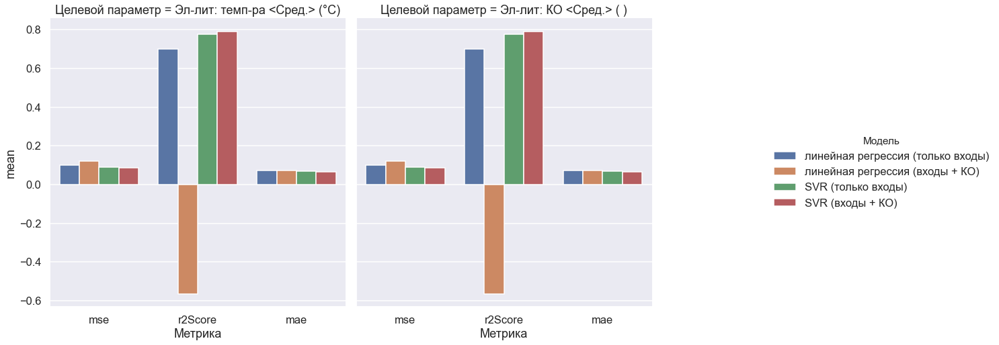

In [ ]:

g= sns.catplot(x="Метрика", y="mean",
                hue="Модель", col="Целевой параметр",
                data=tempDF, kind="bar")
g.fig.set_figwidth(22)
g.fig.set_figheight(8)
#plt.tight_layout(pad=0.4)
#plt.show()

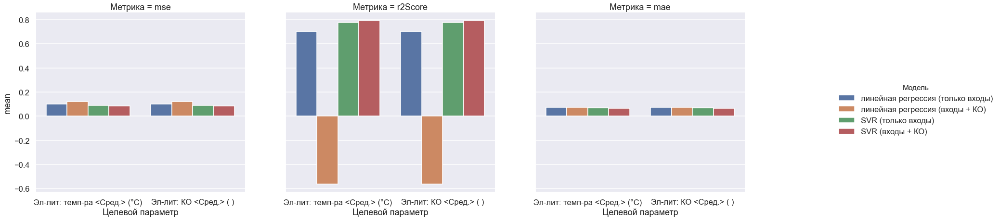

In [ ]:
g = sns.catplot(x="Целевой параметр", y="mean",
                hue="Модель", col="Метрика",
                data=tempDF, kind="bar")
g.fig.set_figwidth(30)
g.fig.set_figheight(7)
#plt.tight_layout(pad=0.4)
plt.show()

In [ ]:
xAxis=np.arange(1,len(pred)+1)
fig, ax = plt.subplots(figsize=(25,5))
ax.scatter(xAxis,dataTargets['KO'], color='green', marker='.', label='данные')
ax.scatter(xAxis,pred, color='red', marker='.', label='модель')
ax.set_xlim(1,len(pred)+1)
ax.legend(fontsize=14)
plt.tight_layout()
plt.show()

fig, ax = plt.subplots(figsize=(25,5))
ax.plot(xAxis,dataTargets['KO'], color='green', marker='.', label='данные')
ax.plot(xAxis,pred, color='red', marker='.', label='модель')
ax.set_xlim(1,len(pred)+1)
ax.legend(fontsize=14)
plt.tight_layout()
plt.show()  